In [1]:
## Trim down imports to only neccesary 

import pandas as pd
import numpy as np
from sklearn.model_selection import train_test_split
from sklearn.metrics import r2_score
from transformers import AutoFeatureExtractor, ViTForImageClassification, ViTModel
import torch
from torchvision.transforms import v2
import torchvision.transforms as transforms
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
from IPython.core.interactiveshell import InteractiveShell
InteractiveShell.ast_node_interactivity = "all"
pd.set_option('display.max_columns', None)
import warnings
warnings.filterwarnings('default')
from torch.utils.data import Dataset, DataLoader
from torch import nn, optim
from torch.utils.data import Subset
from collections import namedtuple
from sklearn.preprocessing import StandardScaler

import datasets_1 as datasets

import os
import datetime
import re



/Users/willhoff/Desktop/research_23_24/research_09_11/env/lib/python3.11/site-packages/torchvision/datapoints/__init__.py:12: UserWarning: The torchvision.datapoints and torchvision.transforms.v2 namespaces are still Beta. While we do not expect major breaking changes, some APIs may still change according to user feedback. Please submit any feedback you may have in this issue: https://github.com/pytorch/vision/issues/6753, and you can also check out https://github.com/pytorch/vision/issues/7319 to learn more about the APIs that we suspect might involve future changes. You can silence this warning by calling torchvision.disable_beta_transforms_warning().
  warnings.warn(_BETA_TRANSFORMS_WARNING)
/Users/willhoff/Desktop/research_23_24/research_09_11/env/lib/python3.11/site-packages/torchvision/transforms/v2/__init__.py:54: UserWarning: The torchvision.datapoints and torchvision.transforms.v2 namespaces are still Beta. While we do not expect major breaking changes, some APIs may still cha

In [2]:
DATA_DIR = "../data/"

lvid_o = pd.read_excel('../data/LVID_bulk_geochem.xlsx')
lvid_o.head()

lvid_o.columns = lvid_o.columns.str.strip()

lvid_o.head()

print(lvid_o.columns)

# Function to clean column names
def clean_column_name(column_name):
    # Remove text within parentheses
    column_name = re.sub(r' \([^)]*\)', '', column_name)
    # Replace spaces with underscores
    column_name = column_name.replace(' ', '_')
    
    # Convert to lower case
    return column_name.lower().strip()

# Apply the function to each column name
lvid_o.columns = [clean_column_name(col) for col in lvid_o.columns]

# Now df has the cleaned column names
print(lvid_o.columns)

lvid_o.describe()


,Sample ID,Section depth (cm),Cum depth (cm),Age (BP),δ13CVPDB (‰),Total C (µg),%TOC,δ15NAir (‰),Total N (µg),%N,C/N,Sample Weight (mg) from Sample List,Sample mass (ug)
0,20LVID-02A-19,19.0,3.0,-4,-26.801533,1374.888037,7.014735,0.232224,131.049083,0.668618,10.491398,19.6,19600
1,20LVID-02A-22 5,22.5,6.5,58,-24.681210,1464.275417,7.213179,0.196497,135.527495,0.667623,10.804268,20.3,20300
2,20LVID-02A-26,26.0,10.0,127,-24.237128,1101.039173,4.186461,0.947665,100.056127,0.380442,11.004215,26.3,26300
3,20LVID-02A-29 5,29.5,13.0,201,-24.981566,1240.047631,2.966621,1.093422,108.097362,0.258606,11.471581,41.8,41800
4,20LVID-02A-33,33.0,17.0,287,-24.953268,1372.130105,4.848516,0.807939,120.690241,0.426467,11.369023,28.3,28300


,Sample ID,Section depth (cm),Cum depth (cm),Age (BP),δ13CVPDB (‰),Total C (µg),%TOC,δ15NAir (‰),Total N (µg),%N,C/N,Sample Weight (mg) from Sample List,Sample mass (ug)
0,20LVID-02A-19,19.0,3.0,-4,-26.801533,1374.888037,7.014735,0.232224,131.049083,0.668618,10.491398,19.6,19600
1,20LVID-02A-22 5,22.5,6.5,58,-24.681210,1464.275417,7.213179,0.196497,135.527495,0.667623,10.804268,20.3,20300
2,20LVID-02A-26,26.0,10.0,127,-24.237128,1101.039173,4.186461,0.947665,100.056127,0.380442,11.004215,26.3,26300
3,20LVID-02A-29 5,29.5,13.0,201,-24.981566,1240.047631,2.966621,1.093422,108.097362,0.258606,11.471581,41.8,41800
4,20LVID-02A-33,33.0,17.0,287,-24.953268,1372.130105,4.848516,0.807939,120.690241,0.426467,11.369023,28.3,28300


Index(['Sample ID', 'Section depth (cm)', 'Cum depth (cm)', 'Age (BP)',
       'δ13CVPDB (‰)', 'Total C (µg)', '%TOC', 'δ15NAir (‰)', 'Total N (µg)',
       '%N', 'C/N', 'Sample Weight (mg) from Sample List', 'Sample mass (ug)'],
      dtype='object')
Index(['sample_id', 'section_depth', 'cum_depth', 'age', 'δ13cvpdb', 'total_c',
       '%toc', 'δ15nair', 'total_n', '%n', 'c/n',
       'sample_weight_from_sample_list', 'sample_mass'],
      dtype='object')


,section_depth,cum_depth,age,δ13cvpdb,total_c,%toc,δ15nair,total_n,%n,c/n,sample_weight_from_sample_list,sample_mass
count,150.000000,150.000000,150.000000,150.000000,150.000000,150.000000,150.000000,150.000000,150.000000,150.000000,150.000000,150.000000
mean,63.826667,362.603333,5066.813333,-21.634565,741.113416,5.157700,-0.739569,87.637395,0.618401,8.152921,15.844000,15844.000000
std,36.199206,235.335134,2700.912998,1.637360,298.100461,2.264667,0.931660,30.534376,0.260289,1.438938,7.426792,7426.792419
min,8.500000,3.000000,-4.000000,-34.868342,47.825859,0.185372,-2.490998,9.584512,0.040582,3.858221,6.800000,6800.000000
25%,33.000000,133.375000,2793.250000,-21.852532,653.330397,3.951033,-1.262207,77.671604,0.451463,7.732681,11.700000,11700.000000
50%,60.500000,361.000000,5645.500000,-21.278198,757.339882,5.735836,-0.998697,94.190983,0.688001,8.211551,13.400000,13400.000000
75%,90.000000,590.125000,7425.250000,-20.809372,915.712166,6.686495,-0.494918,107.725388,0.812283,8.878720,16.850000,16850.000000
max,155.000000,724.500000,9055.000000,-19.391919,1464.275417,10.719894,2.959212,137.447915,1.069600,11.471581,56.700000,56700.000000


In [3]:
class ImageData:
    def __init__(self, name, image):
        self.name = name
        self.image = image
        self.start = None
        self.end = None

4ILLUME-LVID20-1B-4B-1-A.jpg 4


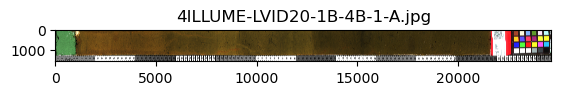

2ILLUME-LVID20-1B-2B-1-A.jpg 2


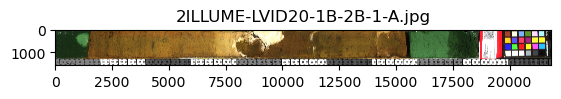

1ILLUME-LVID20-1B-1B-1-A.jpg 1


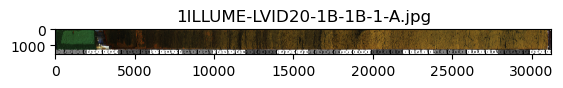

6ILLUME-LVID20-1A-5B-1-A.jpg 6


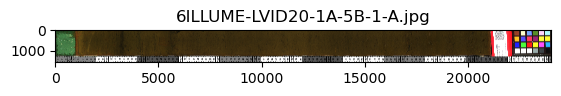

8ILLUME-LVID20-1A-7B-1-A.jpg 8


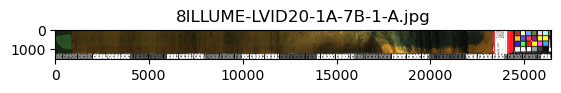

3ILLUME-LVID20-1B-3B-1-A.jpg 3


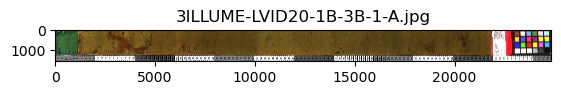

5ILLUME-LVID20-1A-4B-1-A.jpg 5


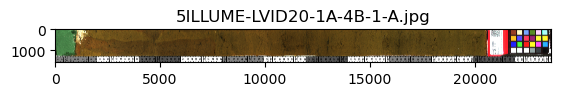

7ILLUME-LVID20-1A-6B-1-A.jpg 7


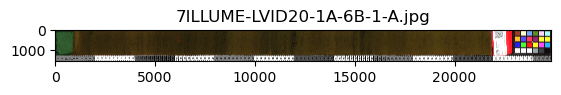

9ILLUME-LVID20-1A-8B-1-A.jpg 9


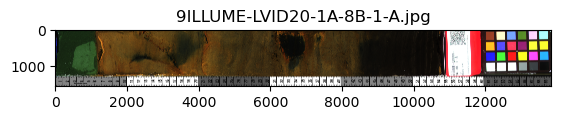

In [4]:
full_LVID = []
cropped_LVID = []

def sortimg(img):
    return img.name

def load_and_display_images(folder_path, img_store):
    # List all files in the folder
    files = os.listdir(folder_path)

    for file in files:
        # Construct full file path
        file_path = os.path.join(folder_path, file)
        obj_name = file[0]
        print(file,obj_name)
        # Check if the file is an image (you can add more extensions if needed)
        if file_path.lower().endswith(('.png', '.jpg', '.jpeg')):
            # Load the image
            img = mpimg.imread(file_path)

            new_img = ImageData(name=obj_name, image=img)
            
            # Display the image
            plt.imshow(img)
            plt.title(file)
            plt.show()
            
            img_store.append(new_img)

# Replace 'your_folder_path' with the path to the folder containing your images

load_and_display_images('img_data/LVID',full_LVID)
## reverse = False because 1B-7B seems darkest so would make sense for it to be on the bottom
full_LVID.sort(key=sortimg,reverse=False)

In [5]:
def crop_image(image_data, box, display = True):
    # Unpack the box coordinates
    left, lower, right, upper = box

    # Crop the image using array slicing
    cropped_image = image_data.image[lower:upper, left:right]

    # Update image data
    cropped = cropped_image

    # Optionally, display the cropped image
    if display:
        plt.imshow(cropped)
        plt.axis('off')  # This hides the axis
        plt.show()

    return cropped




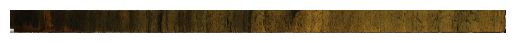

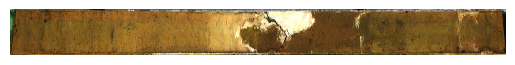

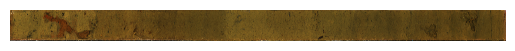

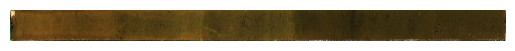

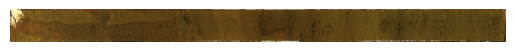

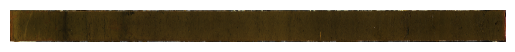

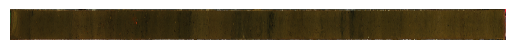

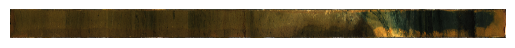

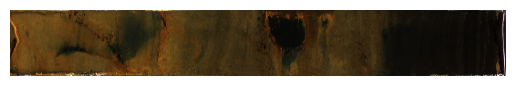

In [6]:
##### CROPPING IMAGES --- IDK HOW TO DO THIS NOT MANUALLY

## Cropping Unnecesary parts
# Left, top, right, bottom

## This is only guessing, do something better potentially. More fine grain
## 1. 3200 0 31075 1300
    ## 17-156 cm
    

start = 3200
end = 31075
box = (start, 0, end, 1300)

full_LVID[0].start = start
full_LVID[0].end = end

cropped_image = crop_image(full_LVID[0], box)
cropped_LVID.append(ImageData(full_LVID[0].name,cropped_image))


## This is only guessing, do something better potentially. More fine grain
## 2. 1400 0 15525 1300
    ## 8-78 cm 
start = 1400
end = 15525
box = (start, 0, end, 1300)
full_LVID[1].start = start
full_LVID[1].end = end

cropped_image = crop_image(full_LVID[1], box)
cropped_LVID.append(ImageData(full_LVID[1].name,cropped_image))

## This is only guessing, do something better potentially. More fine grain
## 3. 1200 0 21850 1300
    ## 7-109.5 cm
start = 1200
end = 21850
box = (start, 0, end, 1300)

full_LVID[2].start = start
full_LVID[2].end = end

cropped_image = crop_image(full_LVID[2], box)
cropped_LVID.append(ImageData(full_LVID[2].name,cropped_image))

## This is only guessing, do something better potentially. More fine grain
## 4. 1000 0 21650 1300
    ## 6-108.5 cm
start = 1000
end = 21650
box = (start, 0, end, 1300)

full_LVID[3].start = start
full_LVID[3].end = end

cropped_image = crop_image(full_LVID[3], box)
cropped_LVID.append(ImageData(full_LVID[3].name,cropped_image))

## This is only guessing, do something better potentially. More fine grain
## 5. 1000 0 20600 1300
    ## 6-103.5 cm
start = 1000
end = 20600
box = (start, 0, end, 1300)

full_LVID[4].start = start
full_LVID[4].end = end

cropped_image = crop_image(full_LVID[4], box)
cropped_LVID.append(ImageData(full_LVID[4].name,cropped_image))

## This is only guessing, do something better potentially. More fine grain
## 6. 1000 0 21150 1300
    ## 6-106 cm
start = 1000
end = 21150
box = (start, 0, end, 1300)

full_LVID[5].start = start
full_LVID[5].end = end

cropped_image = crop_image(full_LVID[5], box)
cropped_LVID.append(ImageData(full_LVID[5].name,cropped_image))

## This is only guessing, do something better potentially. More fine grain
## 7. 900 0 21900 1300
    ## 5.5-110 cm
start = 900
end = 21900
box = (start, 0, end, 1300)

full_LVID[6].start = start
full_LVID[6].end = end

cropped_image = crop_image(full_LVID[6], box)
cropped_LVID.append(ImageData(full_LVID[6].name,cropped_image))

## 8. 900 0 23400 1300
    ## 5.5-117.5 cm
start = 900
end = 23400
box = (start, 0, end, 1300)

full_LVID[7].start = start
full_LVID[7].end = end

cropped_image = crop_image(full_LVID[7], box)
cropped_LVID.append(ImageData(full_LVID[7].name,cropped_image))

## 9. 1200 0 10900 1300
    ## 7-54.5 cm

start = 1200
end = 10900
box = (start, 0, end, 1300)

full_LVID[8].start = start
full_LVID[8].end = end

cropped_image = crop_image(full_LVID[8], box)
cropped_LVID.append(ImageData(full_LVID[8].name,cropped_image))


<Figure size 640x480 with 0 Axes>

(-0.5, 996.5, 1299.5, -0.5)

Text(0.5, 1.0, 'Chunk 1')

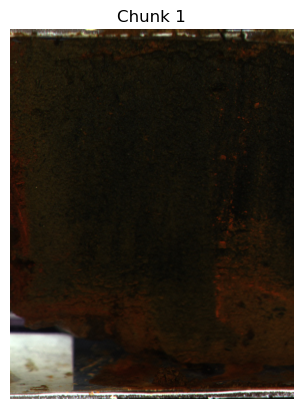

<Figure size 640x480 with 0 Axes>

(-0.5, 996.5, 1299.5, -0.5)

Text(0.5, 1.0, 'Chunk 2')

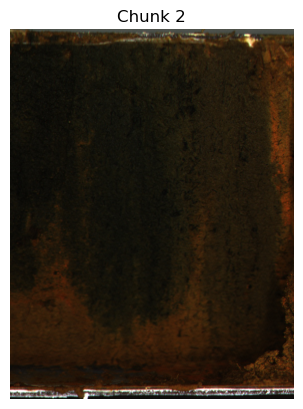

<Figure size 640x480 with 0 Axes>

(-0.5, 996.5, 1299.5, -0.5)

Text(0.5, 1.0, 'Chunk 3')

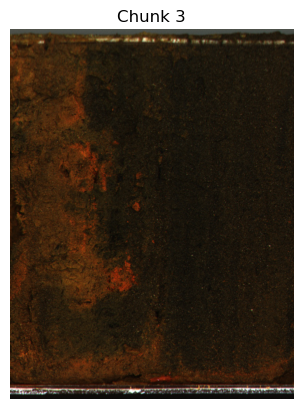

<Figure size 640x480 with 0 Axes>

(-0.5, 996.5, 1299.5, -0.5)

Text(0.5, 1.0, 'Chunk 4')

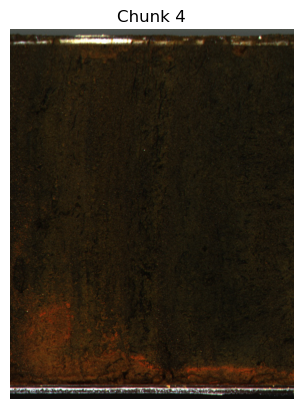

<Figure size 640x480 with 0 Axes>

(-0.5, 996.5, 1299.5, -0.5)

Text(0.5, 1.0, 'Chunk 5')

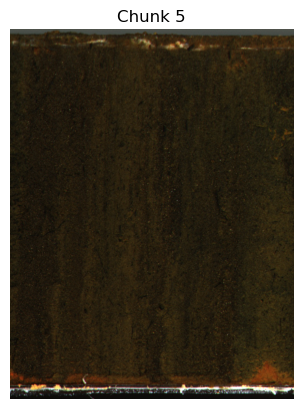

<Figure size 640x480 with 0 Axes>

(-0.5, 996.5, 1299.5, -0.5)

Text(0.5, 1.0, 'Chunk 6')

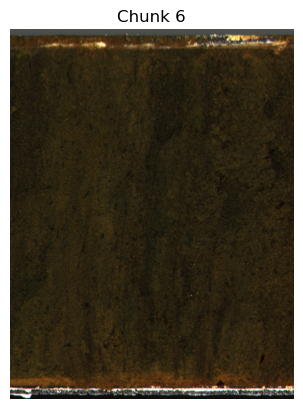

<Figure size 640x480 with 0 Axes>

(-0.5, 996.5, 1299.5, -0.5)

Text(0.5, 1.0, 'Chunk 7')

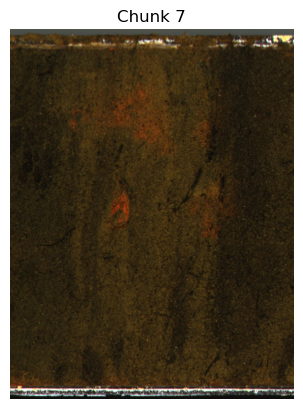

<Figure size 640x480 with 0 Axes>

(-0.5, 996.5, 1299.5, -0.5)

Text(0.5, 1.0, 'Chunk 8')

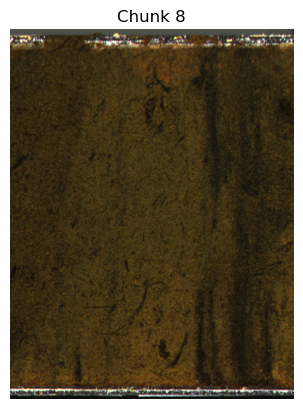

<Figure size 640x480 with 0 Axes>

(-0.5, 996.5, 1299.5, -0.5)

Text(0.5, 1.0, 'Chunk 9')

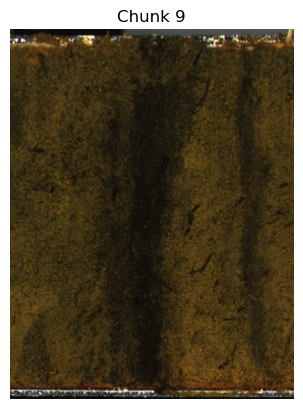

<Figure size 640x480 with 0 Axes>

(-0.5, 996.5, 1299.5, -0.5)

Text(0.5, 1.0, 'Chunk 10')

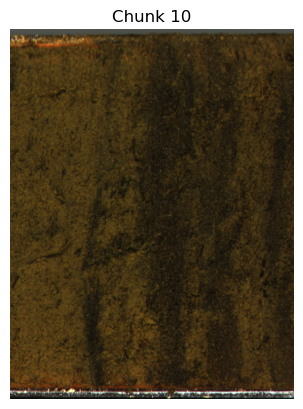

<Figure size 640x480 with 0 Axes>

(-0.5, 996.5, 1299.5, -0.5)

Text(0.5, 1.0, 'Chunk 11')

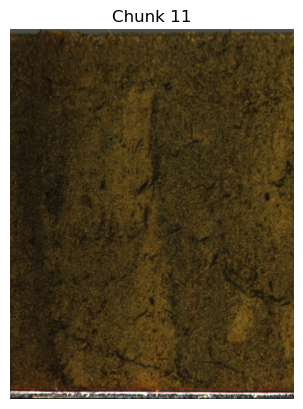

<Figure size 640x480 with 0 Axes>

(-0.5, 996.5, 1299.5, -0.5)

Text(0.5, 1.0, 'Chunk 12')

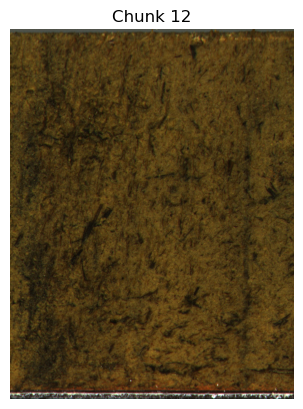

<Figure size 640x480 with 0 Axes>

(-0.5, 996.5, 1299.5, -0.5)

Text(0.5, 1.0, 'Chunk 13')

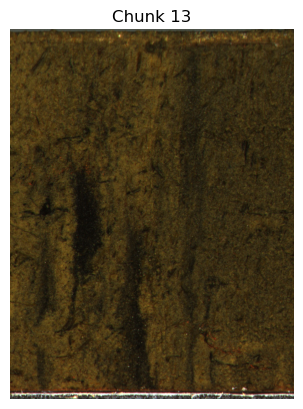

<Figure size 640x480 with 0 Axes>

(-0.5, 996.5, 1299.5, -0.5)

Text(0.5, 1.0, 'Chunk 14')

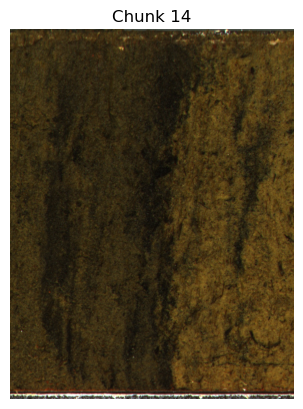

<Figure size 640x480 with 0 Axes>

(-0.5, 996.5, 1299.5, -0.5)

Text(0.5, 1.0, 'Chunk 15')

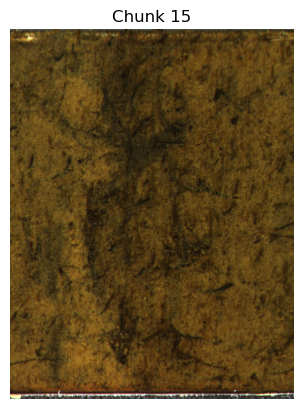

<Figure size 640x480 with 0 Axes>

(-0.5, 996.5, 1299.5, -0.5)

Text(0.5, 1.0, 'Chunk 16')

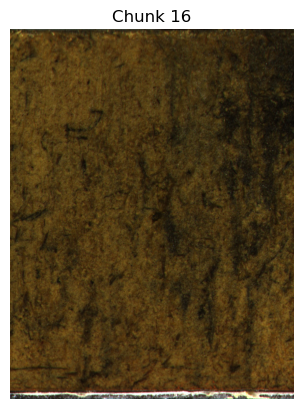

<Figure size 640x480 with 0 Axes>

(-0.5, 996.5, 1299.5, -0.5)

Text(0.5, 1.0, 'Chunk 17')

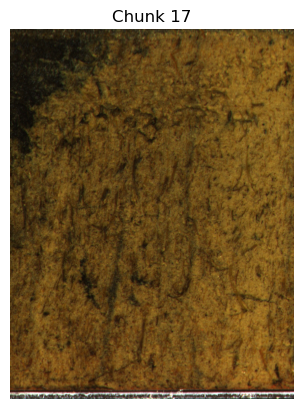

<Figure size 640x480 with 0 Axes>

(-0.5, 996.5, 1299.5, -0.5)

Text(0.5, 1.0, 'Chunk 18')

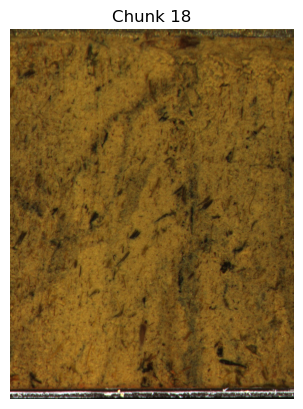

<Figure size 640x480 with 0 Axes>

(-0.5, 996.5, 1299.5, -0.5)

Text(0.5, 1.0, 'Chunk 19')

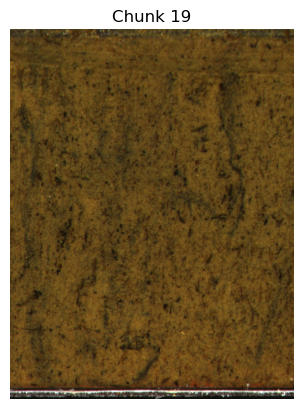

<Figure size 640x480 with 0 Axes>

(-0.5, 996.5, 1299.5, -0.5)

Text(0.5, 1.0, 'Chunk 20')

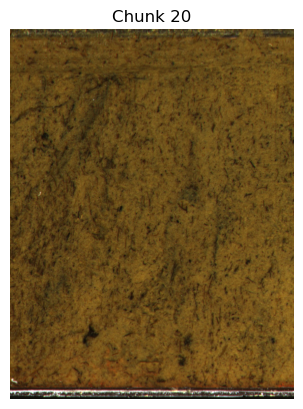

<Figure size 640x480 with 0 Axes>

(-0.5, 996.5, 1299.5, -0.5)

Text(0.5, 1.0, 'Chunk 21')

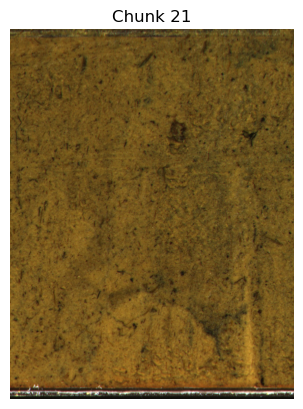

<Figure size 640x480 with 0 Axes>

(-0.5, 996.5, 1299.5, -0.5)

Text(0.5, 1.0, 'Chunk 22')

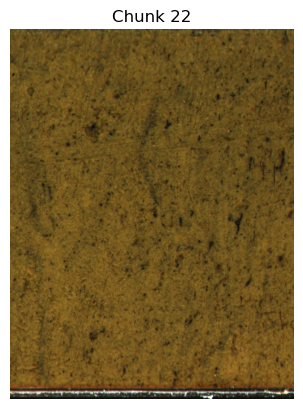

<Figure size 640x480 with 0 Axes>

(-0.5, 996.5, 1299.5, -0.5)

Text(0.5, 1.0, 'Chunk 23')

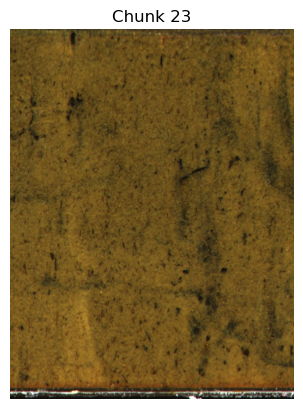

<Figure size 640x480 with 0 Axes>

(-0.5, 996.5, 1299.5, -0.5)

Text(0.5, 1.0, 'Chunk 24')

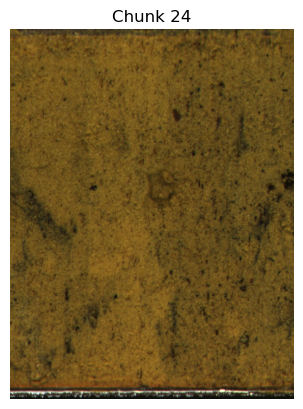

<Figure size 640x480 with 0 Axes>

(-0.5, 996.5, 1299.5, -0.5)

Text(0.5, 1.0, 'Chunk 25')

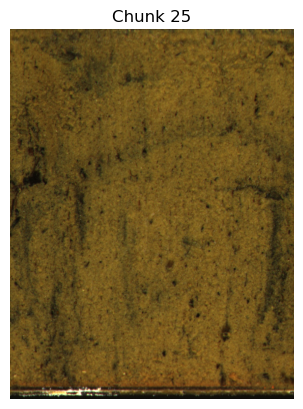

<Figure size 640x480 with 0 Axes>

(-0.5, 996.5, 1299.5, -0.5)

Text(0.5, 1.0, 'Chunk 26')

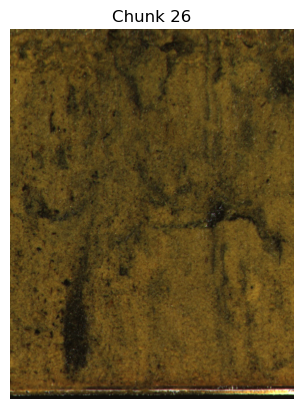

<Figure size 640x480 with 0 Axes>

(-0.5, 996.5, 1299.5, -0.5)

Text(0.5, 1.0, 'Chunk 27')

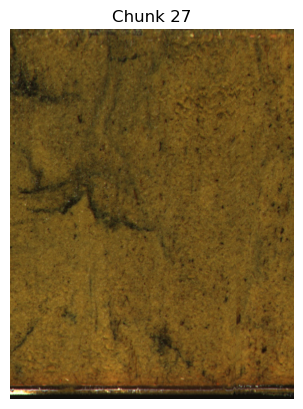

<Figure size 640x480 with 0 Axes>

(-0.5, 996.5, 1299.5, -0.5)

Text(0.5, 1.0, 'Chunk 28')

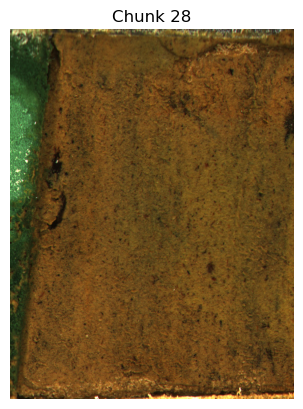

<Figure size 640x480 with 0 Axes>

(-0.5, 996.5, 1299.5, -0.5)

Text(0.5, 1.0, 'Chunk 29')

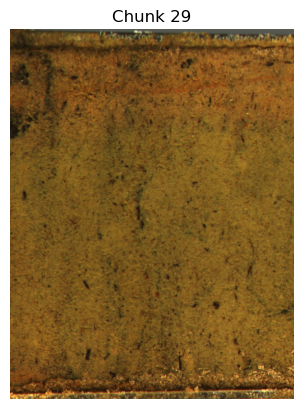

<Figure size 640x480 with 0 Axes>

(-0.5, 996.5, 1299.5, -0.5)

Text(0.5, 1.0, 'Chunk 30')

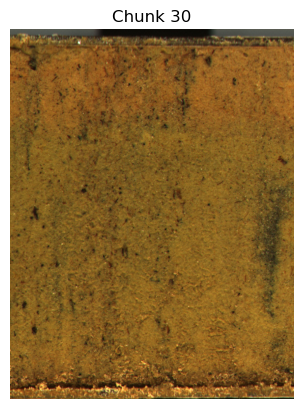

<Figure size 640x480 with 0 Axes>

(-0.5, 996.5, 1299.5, -0.5)

Text(0.5, 1.0, 'Chunk 31')

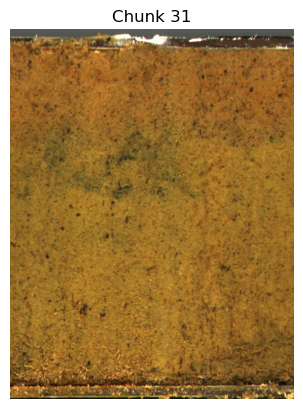

<Figure size 640x480 with 0 Axes>

(-0.5, 996.5, 1299.5, -0.5)

Text(0.5, 1.0, 'Chunk 32')

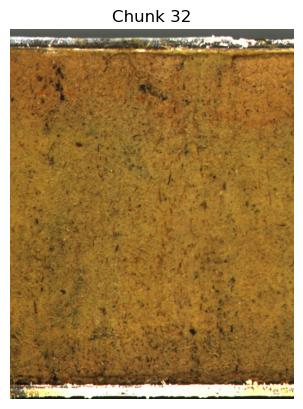

<Figure size 640x480 with 0 Axes>

(-0.5, 996.5, 1299.5, -0.5)

Text(0.5, 1.0, 'Chunk 33')

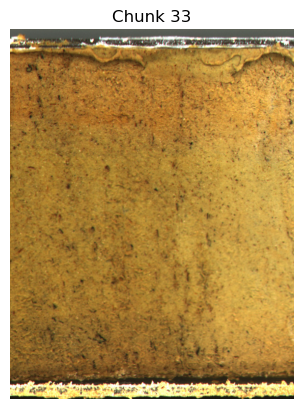

<Figure size 640x480 with 0 Axes>

(-0.5, 996.5, 1299.5, -0.5)

Text(0.5, 1.0, 'Chunk 34')

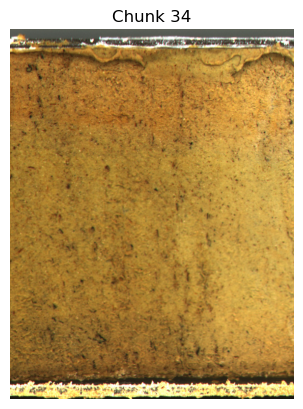

<Figure size 640x480 with 0 Axes>

(-0.5, 996.5, 1299.5, -0.5)

Text(0.5, 1.0, 'Chunk 35')

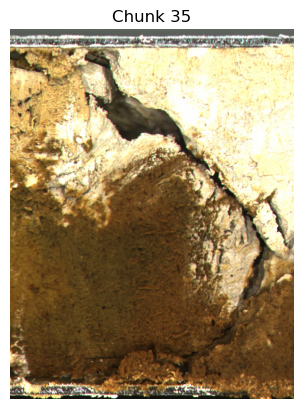

<Figure size 640x480 with 0 Axes>

(-0.5, 996.5, 1299.5, -0.5)

Text(0.5, 1.0, 'Chunk 36')

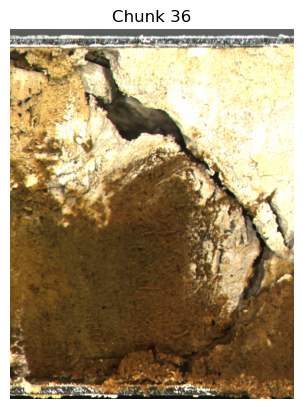

<Figure size 640x480 with 0 Axes>

(-0.5, 996.5, 1299.5, -0.5)

Text(0.5, 1.0, 'Chunk 37')

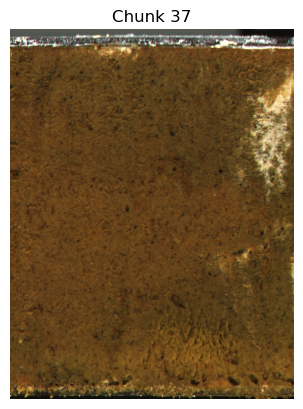

<Figure size 640x480 with 0 Axes>

(-0.5, 996.5, 1299.5, -0.5)

Text(0.5, 1.0, 'Chunk 38')

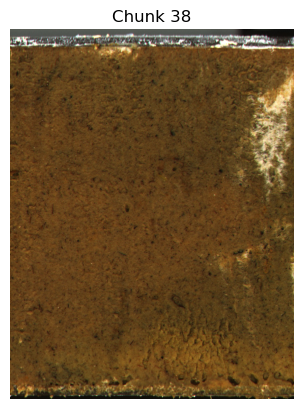

<Figure size 640x480 with 0 Axes>

(-0.5, 996.5, 1299.5, -0.5)

Text(0.5, 1.0, 'Chunk 39')

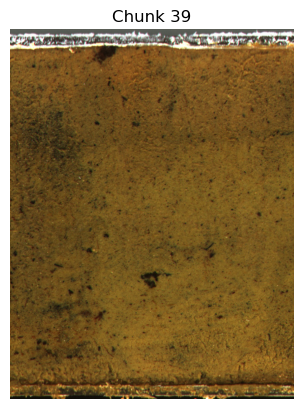

<Figure size 640x480 with 0 Axes>

(-0.5, 996.5, 1299.5, -0.5)

Text(0.5, 1.0, 'Chunk 40')

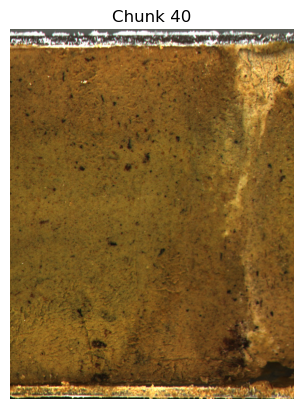

<Figure size 640x480 with 0 Axes>

(-0.5, 996.5, 1299.5, -0.5)

Text(0.5, 1.0, 'Chunk 41')

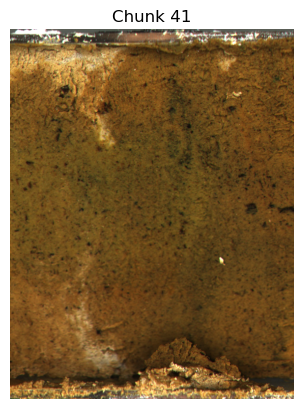

<Figure size 640x480 with 0 Axes>

(-0.5, 996.5, 1299.5, -0.5)

Text(0.5, 1.0, 'Chunk 42')

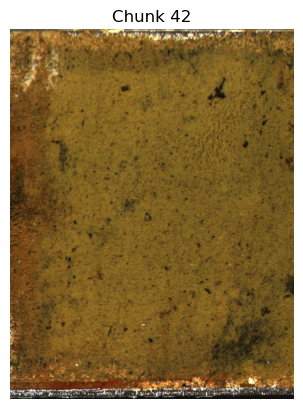

<Figure size 640x480 with 0 Axes>

(-0.5, 996.5, 1299.5, -0.5)

Text(0.5, 1.0, 'Chunk 43')

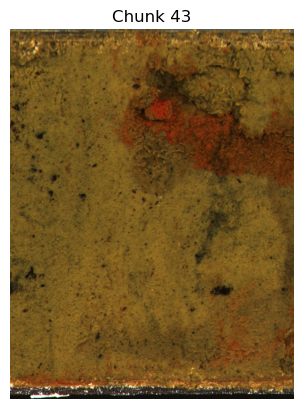

<Figure size 640x480 with 0 Axes>

(-0.5, 996.5, 1299.5, -0.5)

Text(0.5, 1.0, 'Chunk 44')

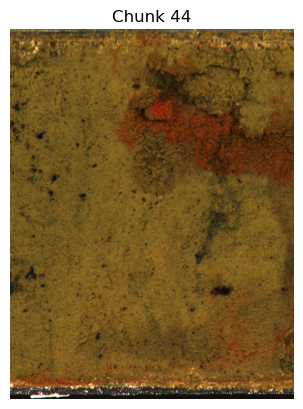

<Figure size 640x480 with 0 Axes>

(-0.5, 996.5, 1299.5, -0.5)

Text(0.5, 1.0, 'Chunk 45')

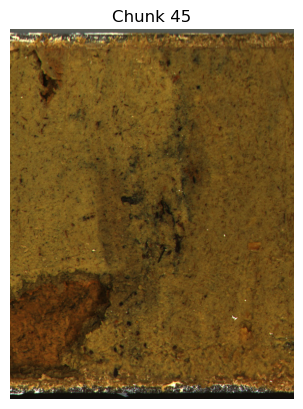

<Figure size 640x480 with 0 Axes>

(-0.5, 996.5, 1299.5, -0.5)

Text(0.5, 1.0, 'Chunk 46')

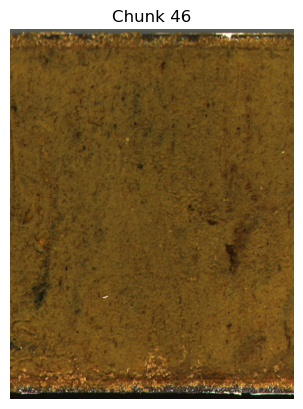

<Figure size 640x480 with 0 Axes>

(-0.5, 996.5, 1299.5, -0.5)

Text(0.5, 1.0, 'Chunk 47')

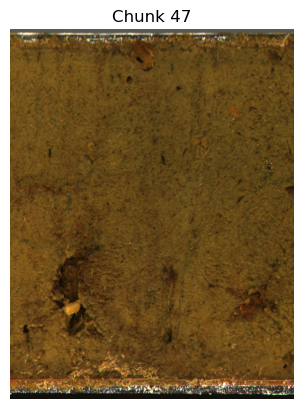

<Figure size 640x480 with 0 Axes>

(-0.5, 996.5, 1299.5, -0.5)

Text(0.5, 1.0, 'Chunk 48')

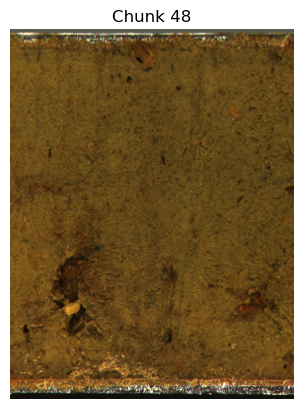

<Figure size 640x480 with 0 Axes>

(-0.5, 996.5, 1299.5, -0.5)

Text(0.5, 1.0, 'Chunk 49')

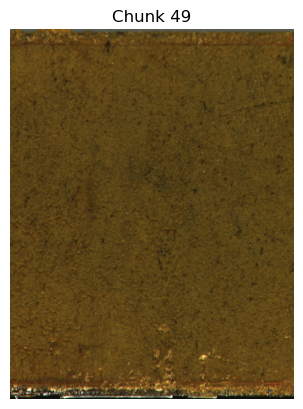

<Figure size 640x480 with 0 Axes>

(-0.5, 996.5, 1299.5, -0.5)

Text(0.5, 1.0, 'Chunk 50')

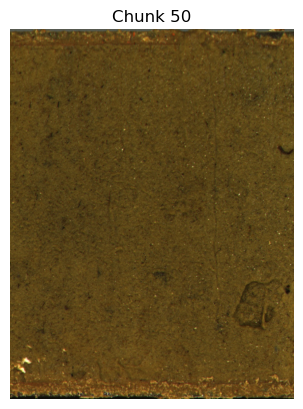

<Figure size 640x480 with 0 Axes>

(-0.5, 996.5, 1299.5, -0.5)

Text(0.5, 1.0, 'Chunk 51')

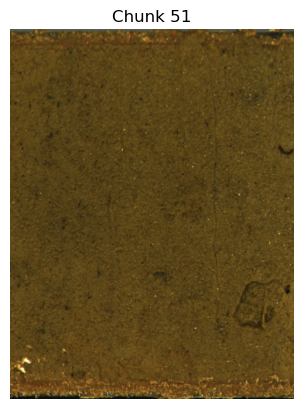

<Figure size 640x480 with 0 Axes>

(-0.5, 996.5, 1299.5, -0.5)

Text(0.5, 1.0, 'Chunk 52')

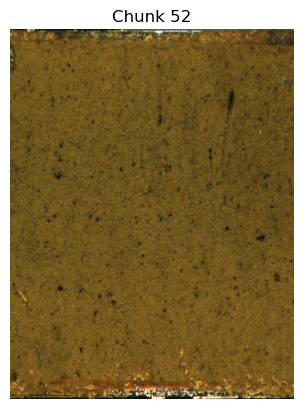

<Figure size 640x480 with 0 Axes>

(-0.5, 996.5, 1299.5, -0.5)

Text(0.5, 1.0, 'Chunk 53')

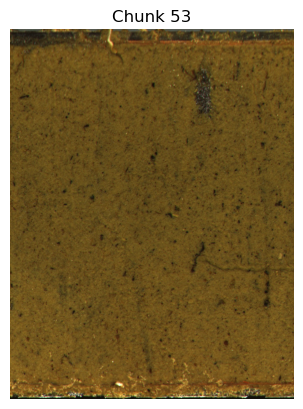

<Figure size 640x480 with 0 Axes>

(-0.5, 996.5, 1299.5, -0.5)

Text(0.5, 1.0, 'Chunk 54')

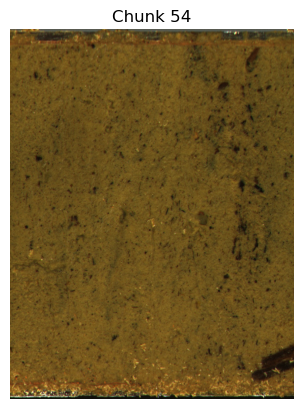

<Figure size 640x480 with 0 Axes>

(-0.5, 996.5, 1299.5, -0.5)

Text(0.5, 1.0, 'Chunk 55')

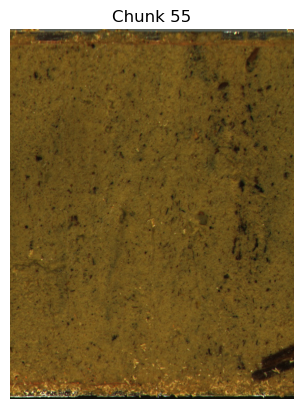

<Figure size 640x480 with 0 Axes>

(-0.5, 996.5, 1299.5, -0.5)

Text(0.5, 1.0, 'Chunk 56')

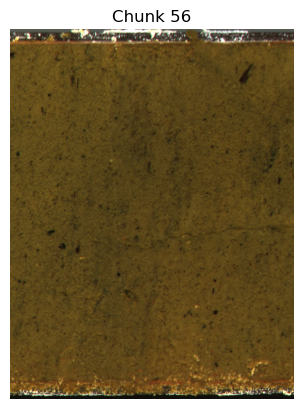

<Figure size 640x480 with 0 Axes>

(-0.5, 996.5, 1299.5, -0.5)

Text(0.5, 1.0, 'Chunk 57')

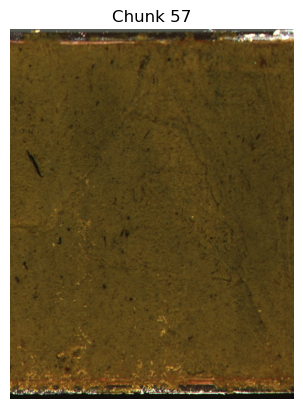

<Figure size 640x480 with 0 Axes>

(-0.5, 996.5, 1299.5, -0.5)

Text(0.5, 1.0, 'Chunk 58')

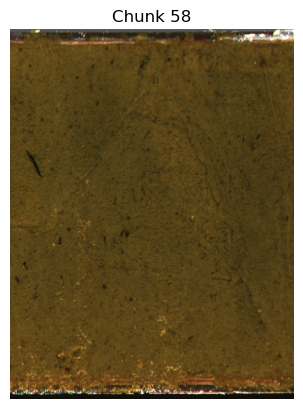

<Figure size 640x480 with 0 Axes>

(-0.5, 996.5, 1299.5, -0.5)

Text(0.5, 1.0, 'Chunk 59')

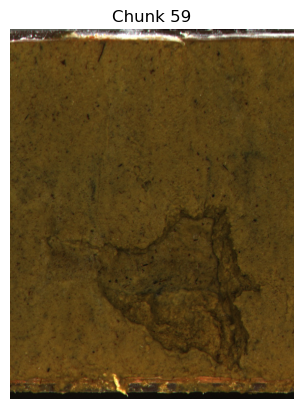

<Figure size 640x480 with 0 Axes>

(-0.5, 996.5, 1299.5, -0.5)

Text(0.5, 1.0, 'Chunk 60')

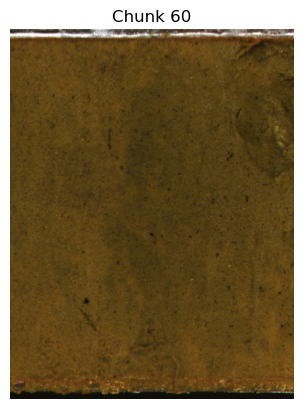

<Figure size 640x480 with 0 Axes>

(-0.5, 996.5, 1299.5, -0.5)

Text(0.5, 1.0, 'Chunk 61')

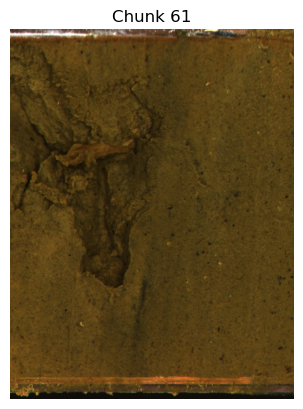

<Figure size 640x480 with 0 Axes>

(-0.5, 996.5, 1299.5, -0.5)

Text(0.5, 1.0, 'Chunk 62')

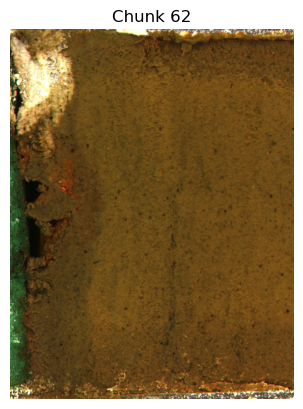

<Figure size 640x480 with 0 Axes>

(-0.5, 996.5, 1299.5, -0.5)

Text(0.5, 1.0, 'Chunk 63')

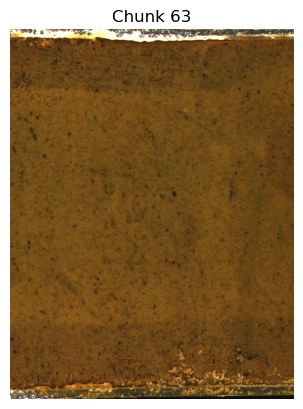

<Figure size 640x480 with 0 Axes>

(-0.5, 996.5, 1299.5, -0.5)

Text(0.5, 1.0, 'Chunk 64')

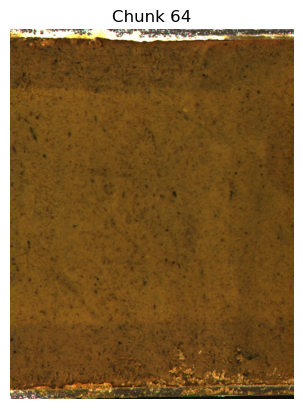

<Figure size 640x480 with 0 Axes>

(-0.5, 996.5, 1299.5, -0.5)

Text(0.5, 1.0, 'Chunk 65')

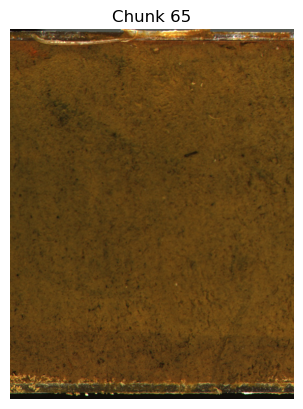

<Figure size 640x480 with 0 Axes>

(-0.5, 996.5, 1299.5, -0.5)

Text(0.5, 1.0, 'Chunk 66')

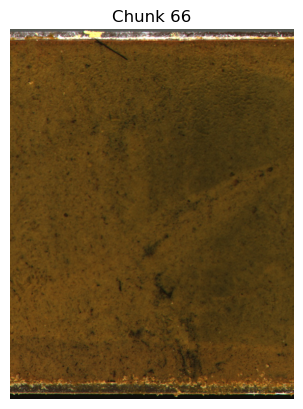

<Figure size 640x480 with 0 Axes>

(-0.5, 996.5, 1299.5, -0.5)

Text(0.5, 1.0, 'Chunk 67')

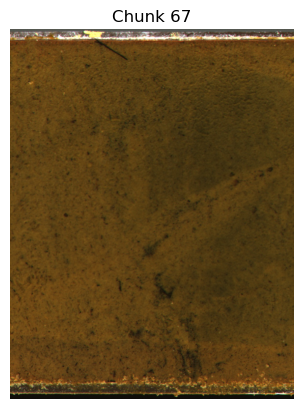

<Figure size 640x480 with 0 Axes>

(-0.5, 996.5, 1299.5, -0.5)

Text(0.5, 1.0, 'Chunk 68')

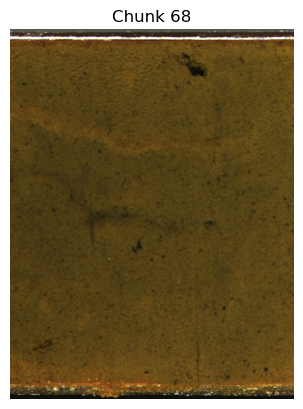

<Figure size 640x480 with 0 Axes>

(-0.5, 996.5, 1299.5, -0.5)

Text(0.5, 1.0, 'Chunk 69')

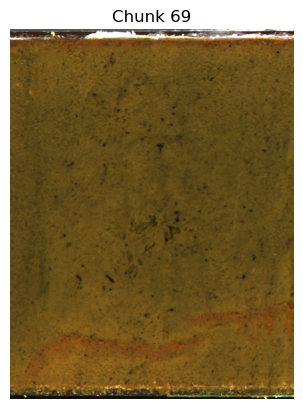

<Figure size 640x480 with 0 Axes>

(-0.5, 996.5, 1299.5, -0.5)

Text(0.5, 1.0, 'Chunk 70')

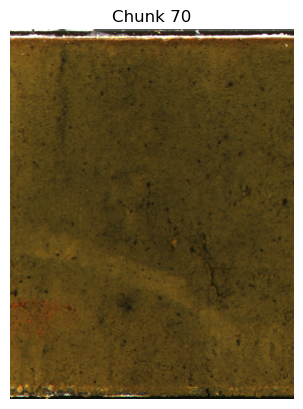

<Figure size 640x480 with 0 Axes>

(-0.5, 996.5, 1299.5, -0.5)

Text(0.5, 1.0, 'Chunk 71')

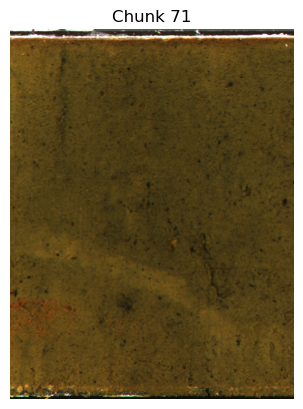

<Figure size 640x480 with 0 Axes>

(-0.5, 996.5, 1299.5, -0.5)

Text(0.5, 1.0, 'Chunk 72')

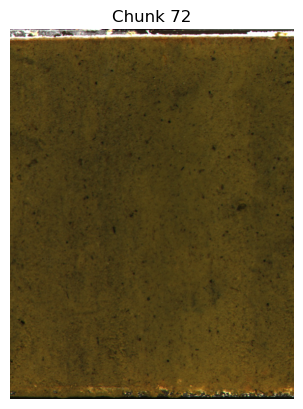

<Figure size 640x480 with 0 Axes>

(-0.5, 996.5, 1299.5, -0.5)

Text(0.5, 1.0, 'Chunk 73')

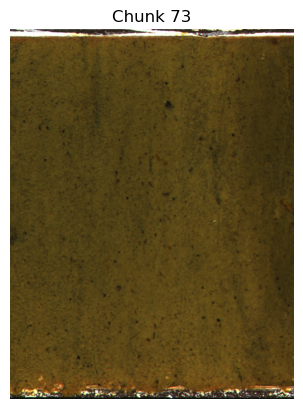

<Figure size 640x480 with 0 Axes>

(-0.5, 996.5, 1299.5, -0.5)

Text(0.5, 1.0, 'Chunk 74')

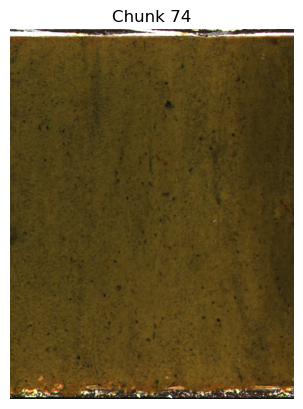

<Figure size 640x480 with 0 Axes>

(-0.5, 996.5, 1299.5, -0.5)

Text(0.5, 1.0, 'Chunk 75')

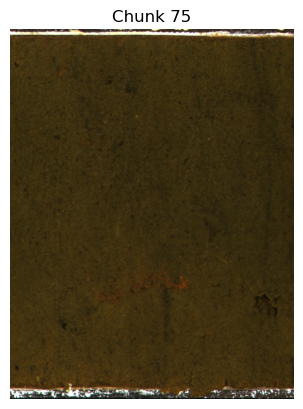

<Figure size 640x480 with 0 Axes>

(-0.5, 996.5, 1299.5, -0.5)

Text(0.5, 1.0, 'Chunk 76')

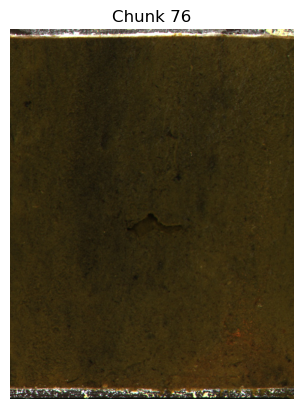

<Figure size 640x480 with 0 Axes>

(-0.5, 996.5, 1299.5, -0.5)

Text(0.5, 1.0, 'Chunk 77')

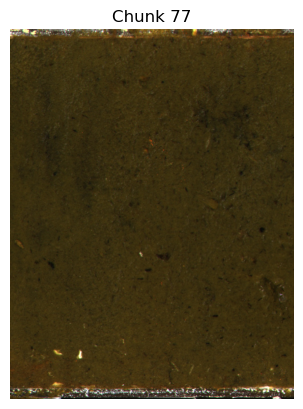

<Figure size 640x480 with 0 Axes>

(-0.5, 996.5, 1299.5, -0.5)

Text(0.5, 1.0, 'Chunk 78')

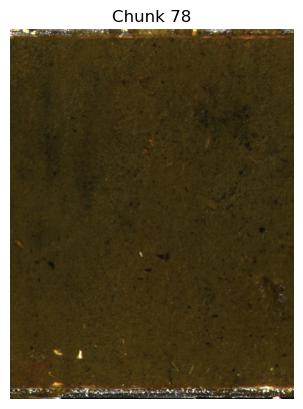

<Figure size 640x480 with 0 Axes>

(-0.5, 996.5, 1299.5, -0.5)

Text(0.5, 1.0, 'Chunk 79')

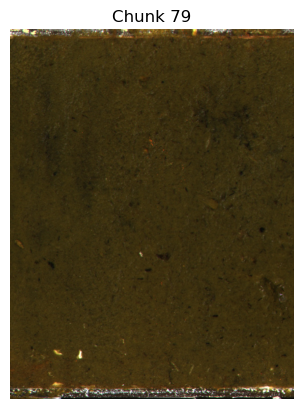

<Figure size 640x480 with 0 Axes>

(-0.5, 996.5, 1299.5, -0.5)

Text(0.5, 1.0, 'Chunk 80')

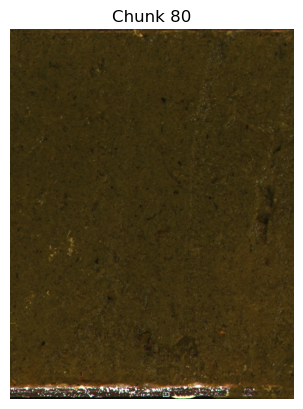

<Figure size 640x480 with 0 Axes>

(-0.5, 996.5, 1299.5, -0.5)

Text(0.5, 1.0, 'Chunk 81')

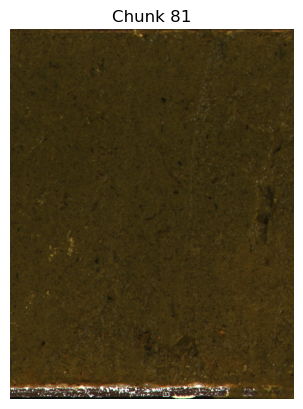

<Figure size 640x480 with 0 Axes>

(-0.5, 996.5, 1299.5, -0.5)

Text(0.5, 1.0, 'Chunk 82')

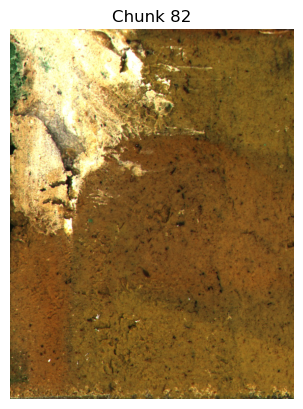

<Figure size 640x480 with 0 Axes>

(-0.5, 996.5, 1299.5, -0.5)

Text(0.5, 1.0, 'Chunk 83')

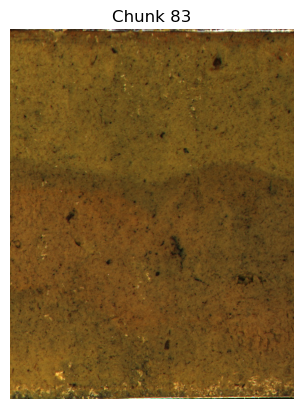

<Figure size 640x480 with 0 Axes>

(-0.5, 996.5, 1299.5, -0.5)

Text(0.5, 1.0, 'Chunk 84')

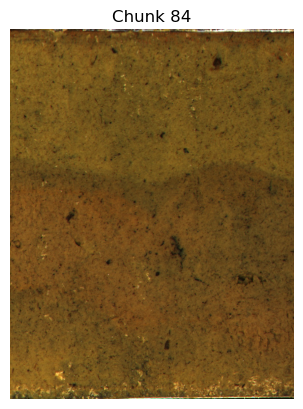

<Figure size 640x480 with 0 Axes>

(-0.5, 996.5, 1299.5, -0.5)

Text(0.5, 1.0, 'Chunk 85')

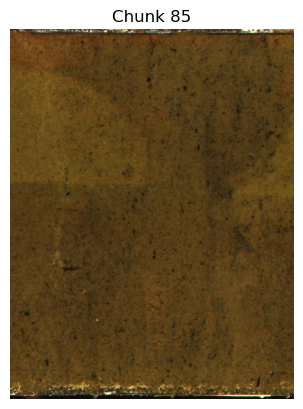

<Figure size 640x480 with 0 Axes>

(-0.5, 996.5, 1299.5, -0.5)

Text(0.5, 1.0, 'Chunk 86')

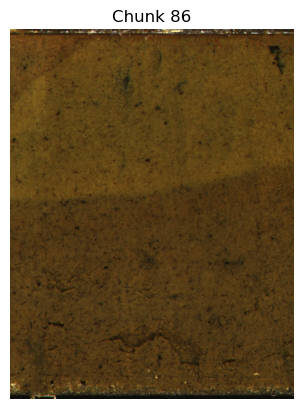

<Figure size 640x480 with 0 Axes>

(-0.5, 996.5, 1299.5, -0.5)

Text(0.5, 1.0, 'Chunk 87')

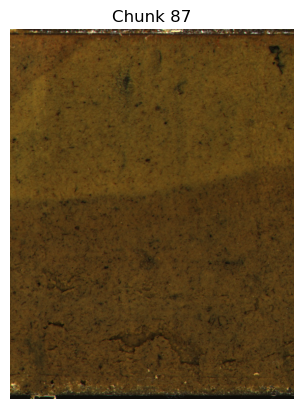

<Figure size 640x480 with 0 Axes>

(-0.5, 996.5, 1299.5, -0.5)

Text(0.5, 1.0, 'Chunk 88')

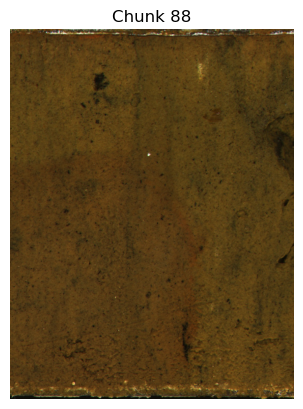

<Figure size 640x480 with 0 Axes>

(-0.5, 996.5, 1299.5, -0.5)

Text(0.5, 1.0, 'Chunk 89')

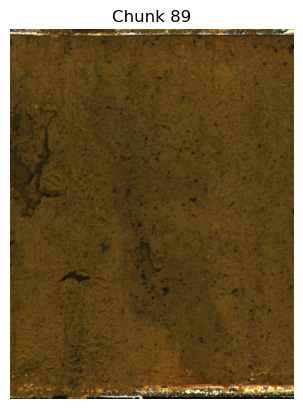

<Figure size 640x480 with 0 Axes>

(-0.5, 996.5, 1299.5, -0.5)

Text(0.5, 1.0, 'Chunk 90')

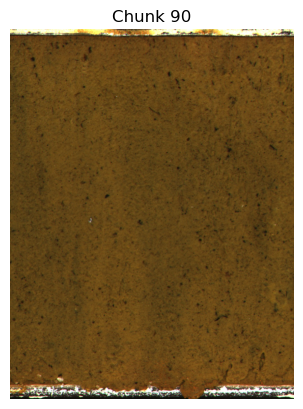

<Figure size 640x480 with 0 Axes>

(-0.5, 996.5, 1299.5, -0.5)

Text(0.5, 1.0, 'Chunk 91')

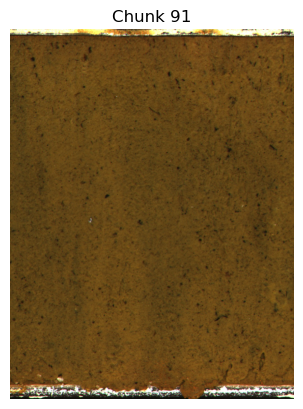

<Figure size 640x480 with 0 Axes>

(-0.5, 996.5, 1299.5, -0.5)

Text(0.5, 1.0, 'Chunk 92')

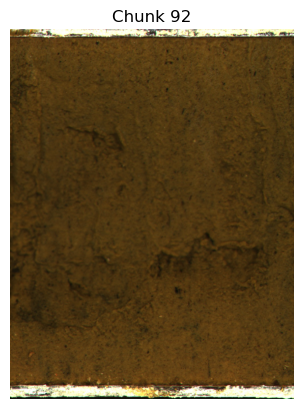

<Figure size 640x480 with 0 Axes>

(-0.5, 996.5, 1299.5, -0.5)

Text(0.5, 1.0, 'Chunk 93')

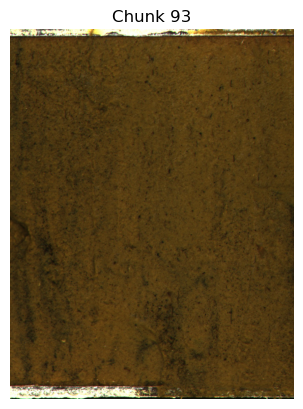

<Figure size 640x480 with 0 Axes>

(-0.5, 996.5, 1299.5, -0.5)

Text(0.5, 1.0, 'Chunk 94')

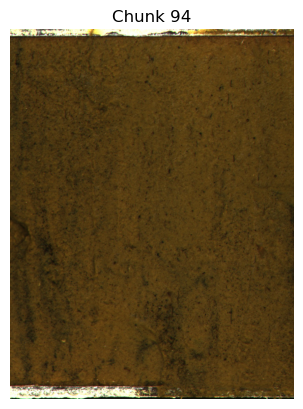

<Figure size 640x480 with 0 Axes>

(-0.5, 996.5, 1299.5, -0.5)

Text(0.5, 1.0, 'Chunk 95')

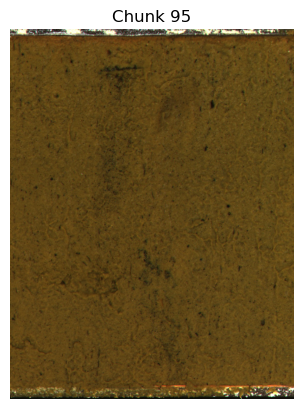

<Figure size 640x480 with 0 Axes>

(-0.5, 996.5, 1299.5, -0.5)

Text(0.5, 1.0, 'Chunk 96')

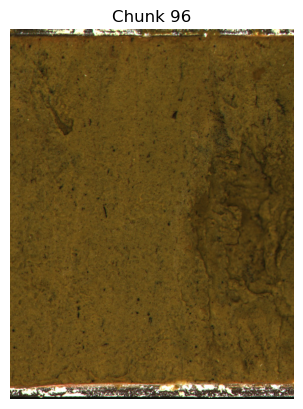

<Figure size 640x480 with 0 Axes>

(-0.5, 996.5, 1299.5, -0.5)

Text(0.5, 1.0, 'Chunk 97')

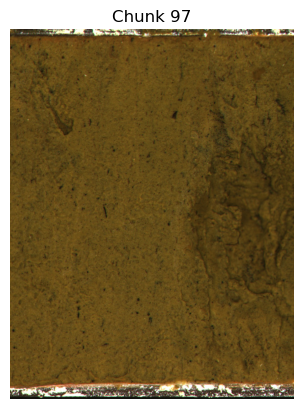

<Figure size 640x480 with 0 Axes>

(-0.5, 996.5, 1299.5, -0.5)

Text(0.5, 1.0, 'Chunk 98')

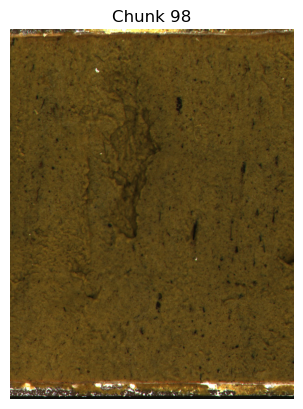

<Figure size 640x480 with 0 Axes>

(-0.5, 996.5, 1299.5, -0.5)

Text(0.5, 1.0, 'Chunk 99')

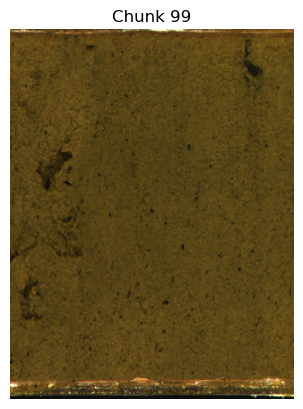

<Figure size 640x480 with 0 Axes>

(-0.5, 996.5, 1299.5, -0.5)

Text(0.5, 1.0, 'Chunk 100')

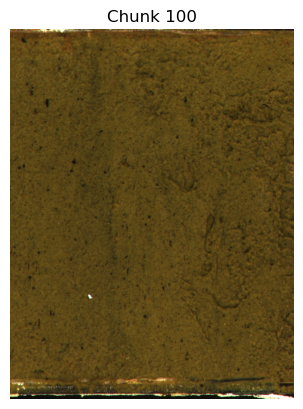

<Figure size 640x480 with 0 Axes>

(-0.5, 996.5, 1299.5, -0.5)

Text(0.5, 1.0, 'Chunk 101')

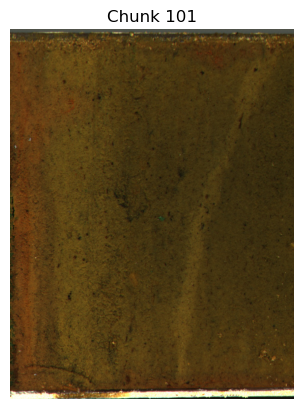

<Figure size 640x480 with 0 Axes>

(-0.5, 996.5, 1299.5, -0.5)

Text(0.5, 1.0, 'Chunk 102')

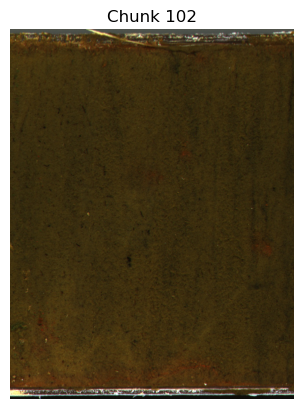

<Figure size 640x480 with 0 Axes>

(-0.5, 996.5, 1299.5, -0.5)

Text(0.5, 1.0, 'Chunk 103')

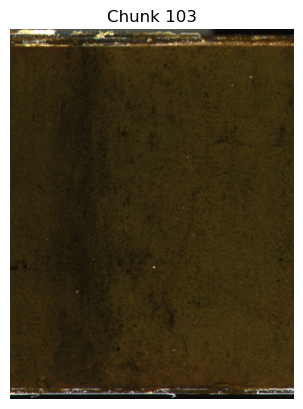

<Figure size 640x480 with 0 Axes>

(-0.5, 996.5, 1299.5, -0.5)

Text(0.5, 1.0, 'Chunk 104')

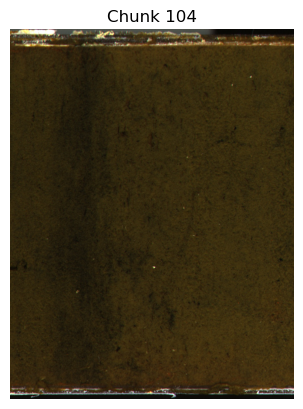

<Figure size 640x480 with 0 Axes>

(-0.5, 996.5, 1299.5, -0.5)

Text(0.5, 1.0, 'Chunk 105')

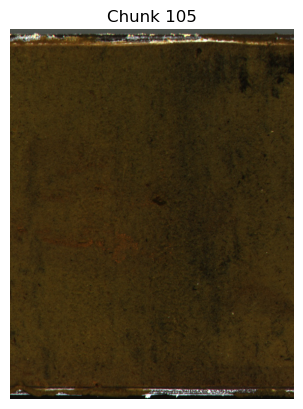

<Figure size 640x480 with 0 Axes>

(-0.5, 996.5, 1299.5, -0.5)

Text(0.5, 1.0, 'Chunk 106')

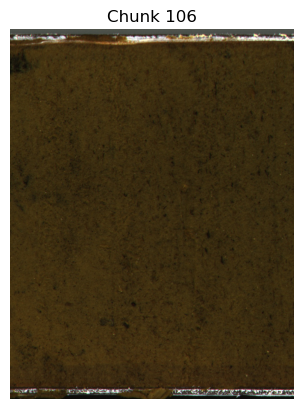

<Figure size 640x480 with 0 Axes>

(-0.5, 996.5, 1299.5, -0.5)

Text(0.5, 1.0, 'Chunk 107')

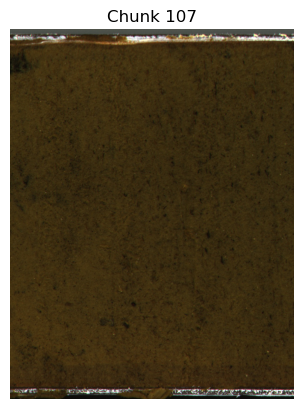

<Figure size 640x480 with 0 Axes>

(-0.5, 996.5, 1299.5, -0.5)

Text(0.5, 1.0, 'Chunk 108')

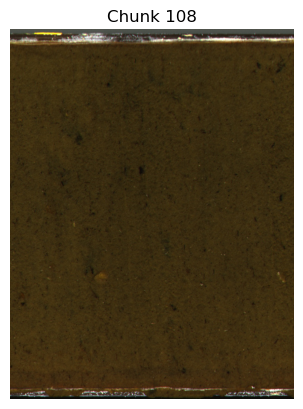

<Figure size 640x480 with 0 Axes>

(-0.5, 996.5, 1299.5, -0.5)

Text(0.5, 1.0, 'Chunk 109')

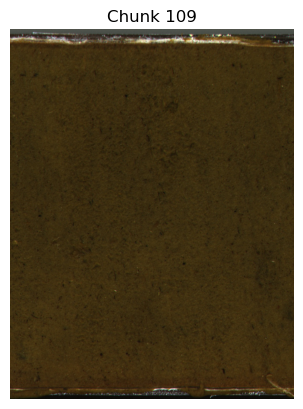

<Figure size 640x480 with 0 Axes>

(-0.5, 996.5, 1299.5, -0.5)

Text(0.5, 1.0, 'Chunk 110')

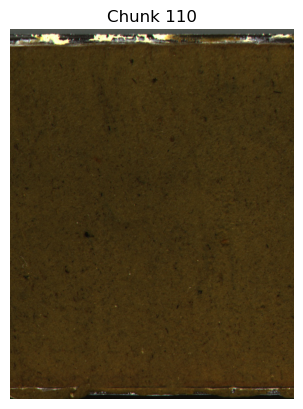

<Figure size 640x480 with 0 Axes>

(-0.5, 996.5, 1299.5, -0.5)

Text(0.5, 1.0, 'Chunk 111')

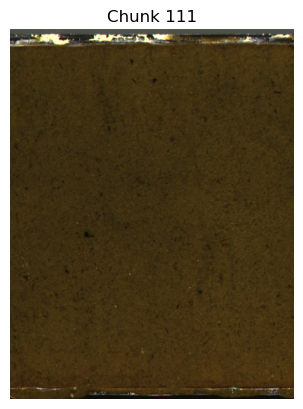

<Figure size 640x480 with 0 Axes>

(-0.5, 996.5, 1299.5, -0.5)

Text(0.5, 1.0, 'Chunk 112')

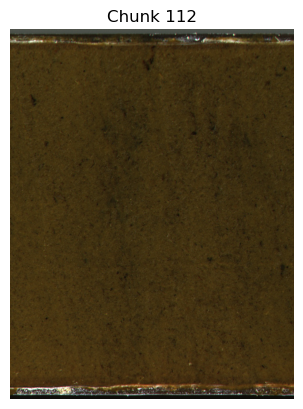

<Figure size 640x480 with 0 Axes>

(-0.5, 996.5, 1299.5, -0.5)

Text(0.5, 1.0, 'Chunk 113')

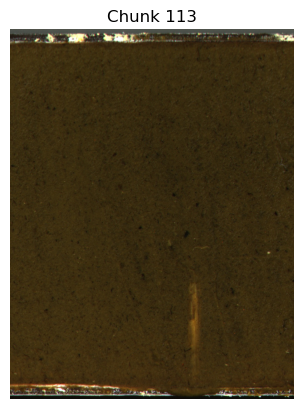

<Figure size 640x480 with 0 Axes>

(-0.5, 996.5, 1299.5, -0.5)

Text(0.5, 1.0, 'Chunk 114')

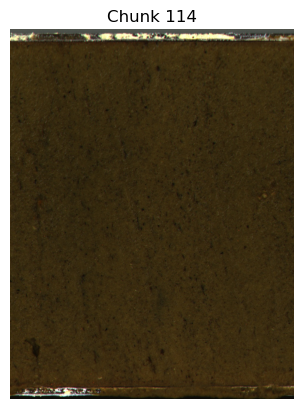

<Figure size 640x480 with 0 Axes>

(-0.5, 996.5, 1299.5, -0.5)

Text(0.5, 1.0, 'Chunk 115')

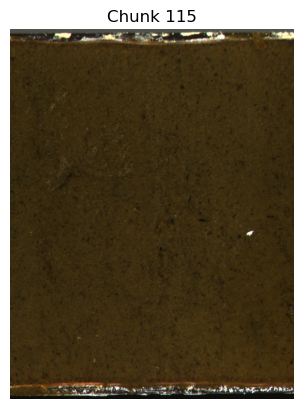

<Figure size 640x480 with 0 Axes>

(-0.5, 996.5, 1299.5, -0.5)

Text(0.5, 1.0, 'Chunk 116')

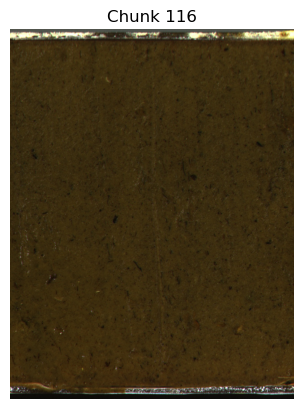

<Figure size 640x480 with 0 Axes>

(-0.5, 996.5, 1299.5, -0.5)

Text(0.5, 1.0, 'Chunk 117')

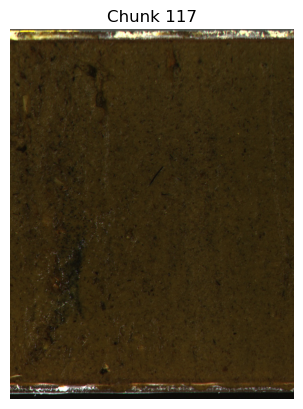

<Figure size 640x480 with 0 Axes>

(-0.5, 996.5, 1299.5, -0.5)

Text(0.5, 1.0, 'Chunk 118')

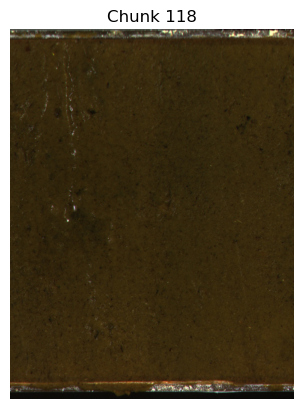

<Figure size 640x480 with 0 Axes>

(-0.5, 996.5, 1299.5, -0.5)

Text(0.5, 1.0, 'Chunk 119')

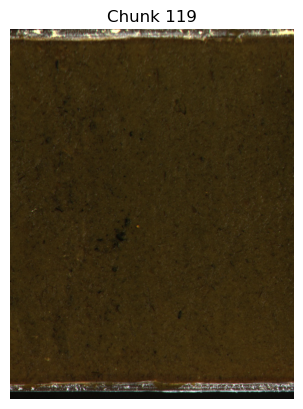

<Figure size 640x480 with 0 Axes>

(-0.5, 996.5, 1299.5, -0.5)

Text(0.5, 1.0, 'Chunk 120')

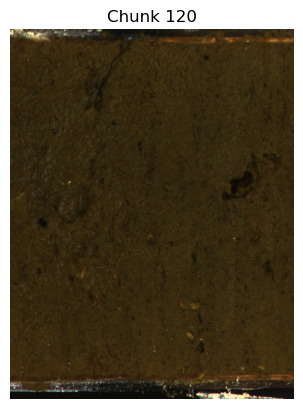

<Figure size 640x480 with 0 Axes>

(-0.5, 996.5, 1299.5, -0.5)

Text(0.5, 1.0, 'Chunk 121')

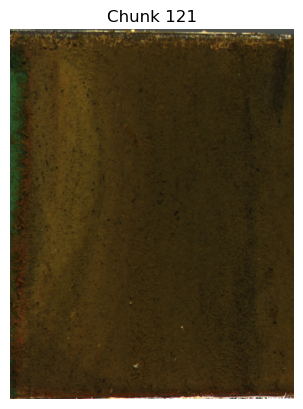

<Figure size 640x480 with 0 Axes>

(-0.5, 996.5, 1299.5, -0.5)

Text(0.5, 1.0, 'Chunk 122')

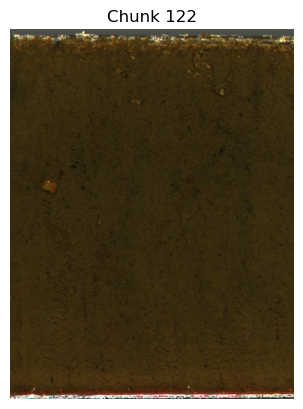

<Figure size 640x480 with 0 Axes>

(-0.5, 996.5, 1299.5, -0.5)

Text(0.5, 1.0, 'Chunk 123')

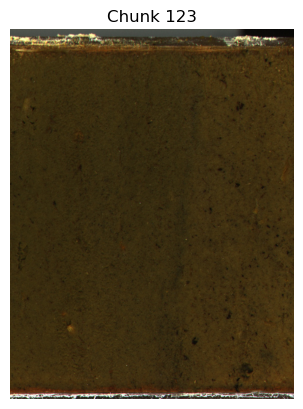

<Figure size 640x480 with 0 Axes>

(-0.5, 996.5, 1299.5, -0.5)

Text(0.5, 1.0, 'Chunk 124')

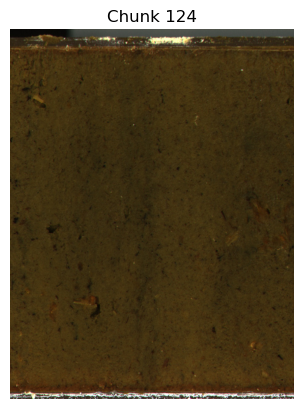

<Figure size 640x480 with 0 Axes>

(-0.5, 996.5, 1299.5, -0.5)

Text(0.5, 1.0, 'Chunk 125')

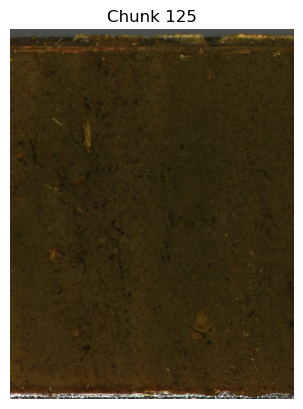

<Figure size 640x480 with 0 Axes>

(-0.5, 996.5, 1299.5, -0.5)

Text(0.5, 1.0, 'Chunk 126')

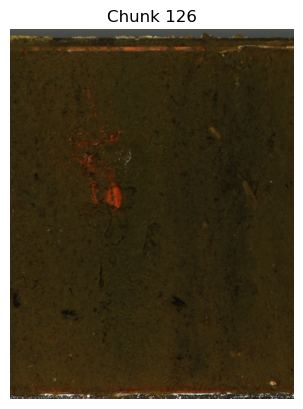

<Figure size 640x480 with 0 Axes>

(-0.5, 996.5, 1299.5, -0.5)

Text(0.5, 1.0, 'Chunk 127')

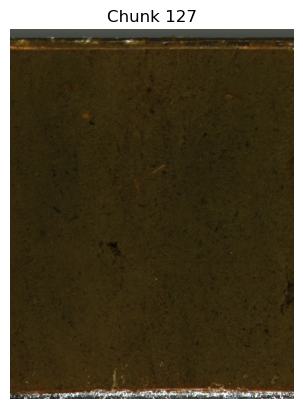

<Figure size 640x480 with 0 Axes>

(-0.5, 996.5, 1299.5, -0.5)

Text(0.5, 1.0, 'Chunk 128')

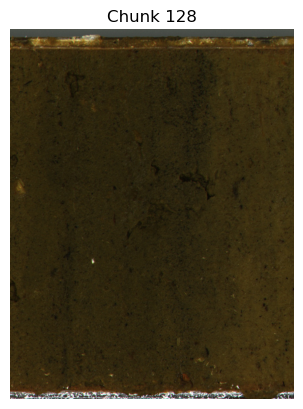

<Figure size 640x480 with 0 Axes>

(-0.5, 996.5, 1299.5, -0.5)

Text(0.5, 1.0, 'Chunk 129')

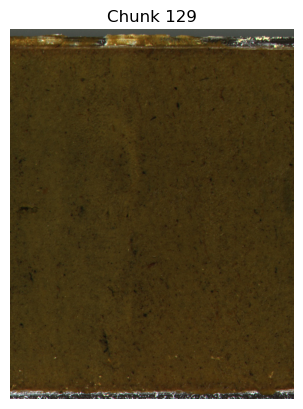

<Figure size 640x480 with 0 Axes>

(-0.5, 996.5, 1299.5, -0.5)

Text(0.5, 1.0, 'Chunk 130')

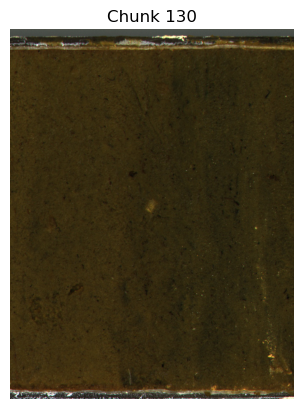

<Figure size 640x480 with 0 Axes>

(-0.5, 996.5, 1299.5, -0.5)

Text(0.5, 1.0, 'Chunk 131')

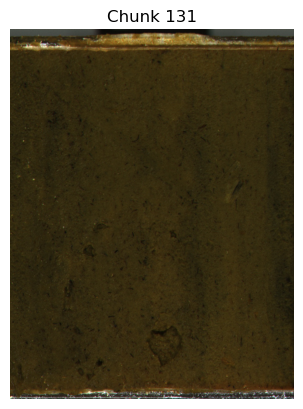

<Figure size 640x480 with 0 Axes>

(-0.5, 996.5, 1299.5, -0.5)

Text(0.5, 1.0, 'Chunk 132')

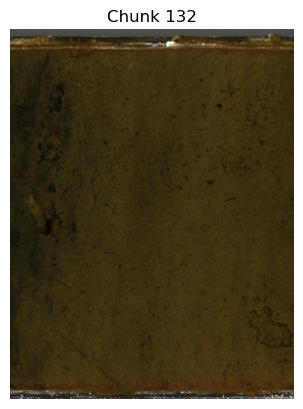

<Figure size 640x480 with 0 Axes>

(-0.5, 996.5, 1299.5, -0.5)

Text(0.5, 1.0, 'Chunk 133')

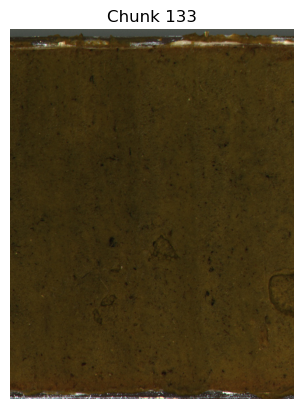

<Figure size 640x480 with 0 Axes>

(-0.5, 996.5, 1299.5, -0.5)

Text(0.5, 1.0, 'Chunk 134')

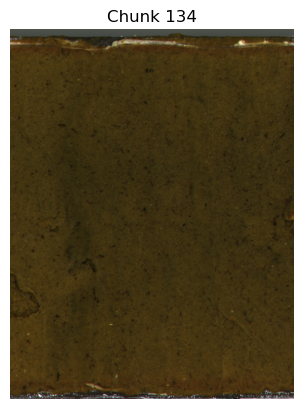

<Figure size 640x480 with 0 Axes>

(-0.5, 996.5, 1299.5, -0.5)

Text(0.5, 1.0, 'Chunk 135')

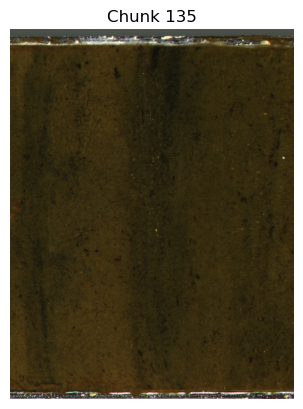

<Figure size 640x480 with 0 Axes>

(-0.5, 996.5, 1299.5, -0.5)

Text(0.5, 1.0, 'Chunk 136')

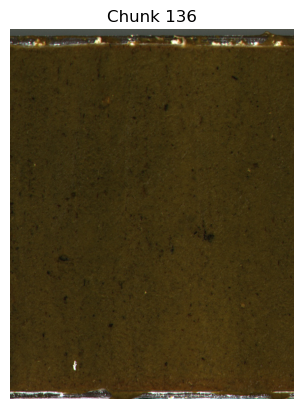

<Figure size 640x480 with 0 Axes>

(-0.5, 996.5, 1299.5, -0.5)

Text(0.5, 1.0, 'Chunk 137')

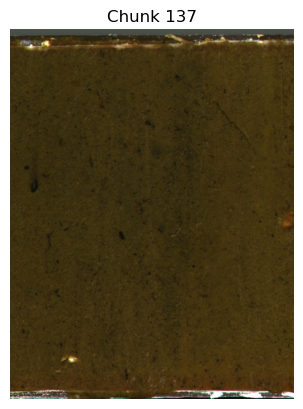

<Figure size 640x480 with 0 Axes>

(-0.5, 996.5, 1299.5, -0.5)

Text(0.5, 1.0, 'Chunk 138')

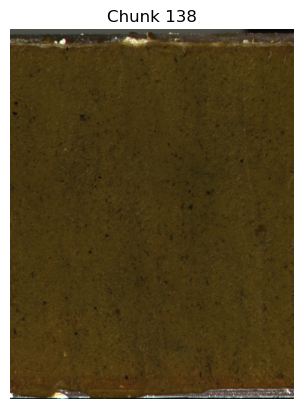

<Figure size 640x480 with 0 Axes>

(-0.5, 996.5, 1299.5, -0.5)

Text(0.5, 1.0, 'Chunk 139')

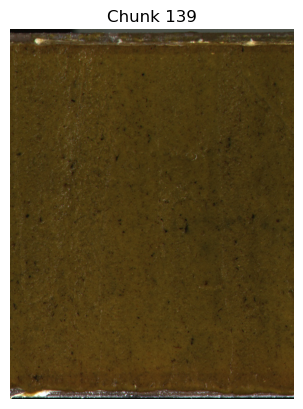

<Figure size 640x480 with 0 Axes>

(-0.5, 996.5, 1299.5, -0.5)

Text(0.5, 1.0, 'Chunk 140')

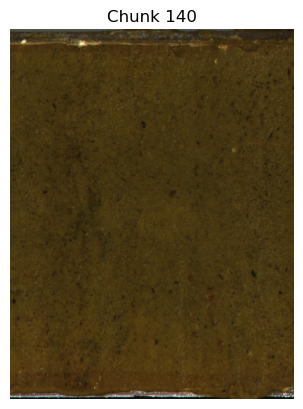

<Figure size 640x480 with 0 Axes>

(-0.5, 996.5, 1299.5, -0.5)

Text(0.5, 1.0, 'Chunk 141')

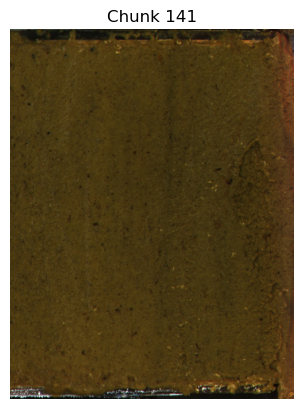

<Figure size 640x480 with 0 Axes>

(-0.5, 996.5, 1299.5, -0.5)

Text(0.5, 1.0, 'Chunk 142')

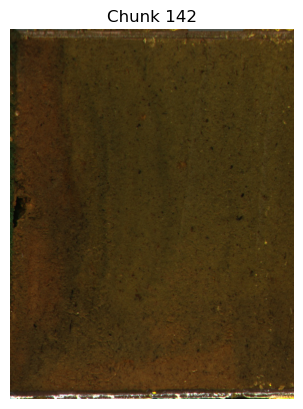

<Figure size 640x480 with 0 Axes>

(-0.5, 996.5, 1299.5, -0.5)

Text(0.5, 1.0, 'Chunk 143')

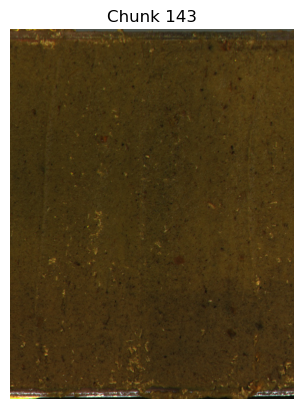

<Figure size 640x480 with 0 Axes>

(-0.5, 996.5, 1299.5, -0.5)

Text(0.5, 1.0, 'Chunk 144')

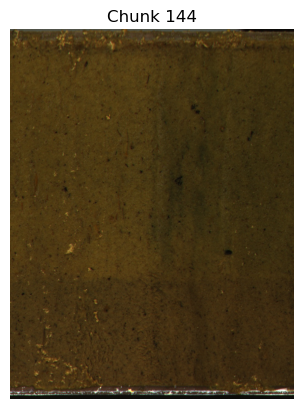

<Figure size 640x480 with 0 Axes>

(-0.5, 996.5, 1299.5, -0.5)

Text(0.5, 1.0, 'Chunk 145')

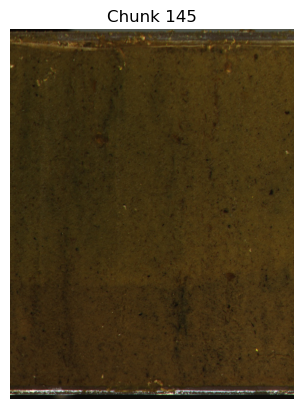

<Figure size 640x480 with 0 Axes>

(-0.5, 996.5, 1299.5, -0.5)

Text(0.5, 1.0, 'Chunk 146')

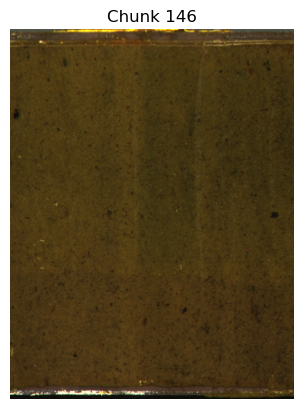

<Figure size 640x480 with 0 Axes>

(-0.5, 996.5, 1299.5, -0.5)

Text(0.5, 1.0, 'Chunk 147')

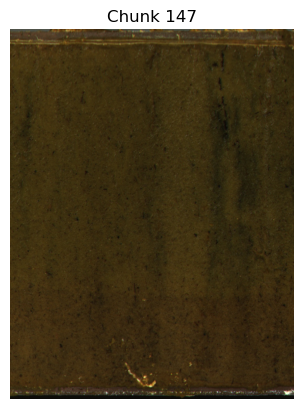

<Figure size 640x480 with 0 Axes>

(-0.5, 996.5, 1299.5, -0.5)

Text(0.5, 1.0, 'Chunk 148')

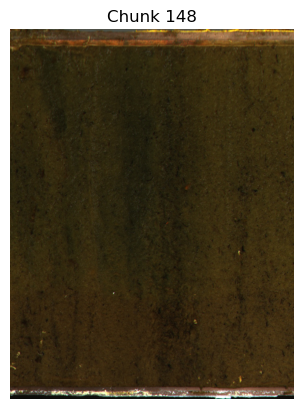

<Figure size 640x480 with 0 Axes>

(-0.5, 996.5, 1299.5, -0.5)

Text(0.5, 1.0, 'Chunk 149')

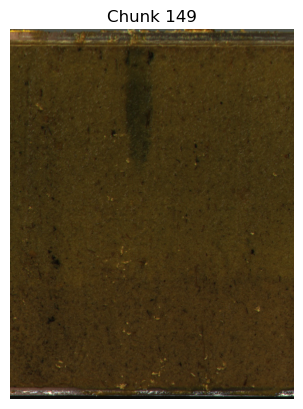

<Figure size 640x480 with 0 Axes>

(-0.5, 996.5, 1299.5, -0.5)

Text(0.5, 1.0, 'Chunk 150')

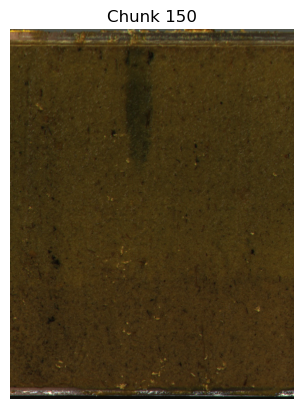

<Figure size 640x480 with 0 Axes>

(-0.5, 996.5, 1299.5, -0.5)

Text(0.5, 1.0, 'Chunk 151')

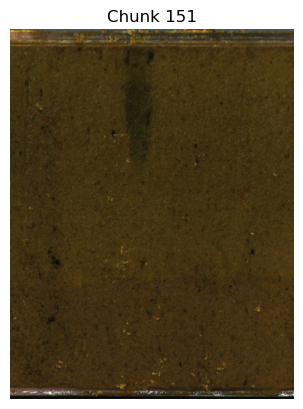

<Figure size 640x480 with 0 Axes>

(-0.5, 996.5, 1299.5, -0.5)

Text(0.5, 1.0, 'Chunk 152')

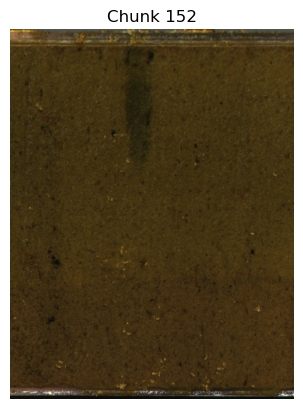

<Figure size 640x480 with 0 Axes>

(-0.5, 996.5, 1299.5, -0.5)

Text(0.5, 1.0, 'Chunk 153')

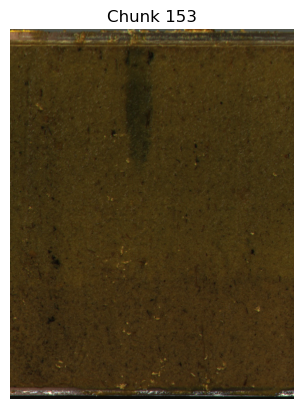

<Figure size 640x480 with 0 Axes>

(-0.5, 996.5, 1299.5, -0.5)

Text(0.5, 1.0, 'Chunk 154')

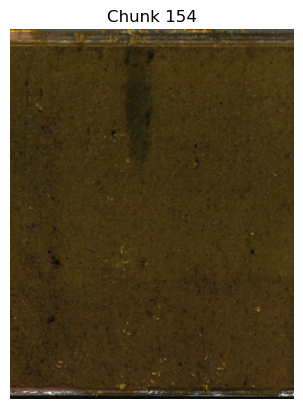

<Figure size 640x480 with 0 Axes>

(-0.5, 996.5, 1299.5, -0.5)

Text(0.5, 1.0, 'Chunk 155')

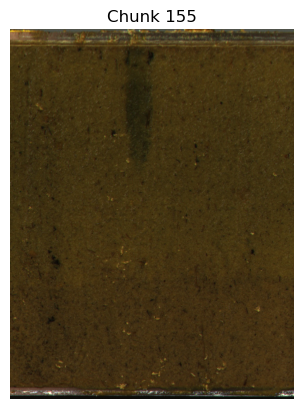

<Figure size 640x480 with 0 Axes>

(-0.5, 996.5, 1299.5, -0.5)

Text(0.5, 1.0, 'Chunk 156')

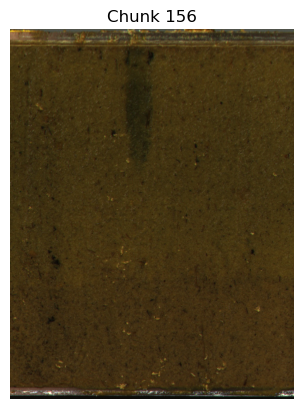

<Figure size 640x480 with 0 Axes>

(-0.5, 996.5, 1299.5, -0.5)

Text(0.5, 1.0, 'Chunk 157')

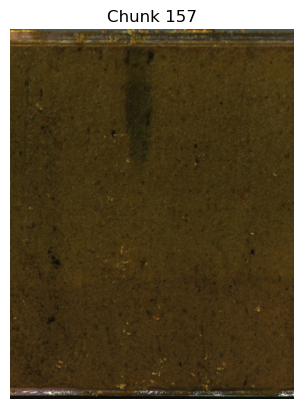

<Figure size 640x480 with 0 Axes>

(-0.5, 996.5, 1299.5, -0.5)

Text(0.5, 1.0, 'Chunk 158')

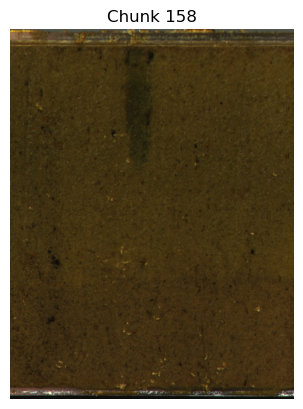

<Figure size 640x480 with 0 Axes>

(-0.5, 996.5, 1299.5, -0.5)

Text(0.5, 1.0, 'Chunk 159')

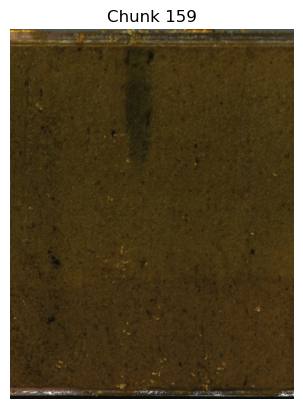

<Figure size 640x480 with 0 Axes>

(-0.5, 996.5, 1299.5, -0.5)

Text(0.5, 1.0, 'Chunk 160')

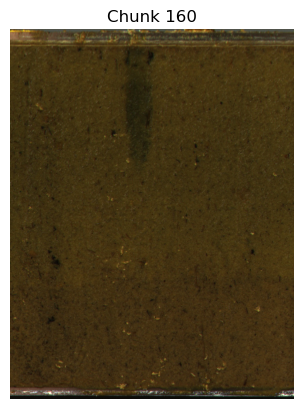

<Figure size 640x480 with 0 Axes>

(-0.5, 996.5, 1299.5, -0.5)

Text(0.5, 1.0, 'Chunk 161')

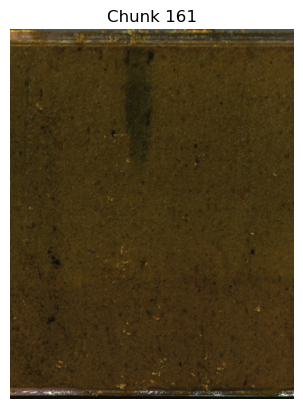

<Figure size 640x480 with 0 Axes>

(-0.5, 996.5, 1299.5, -0.5)

Text(0.5, 1.0, 'Chunk 162')

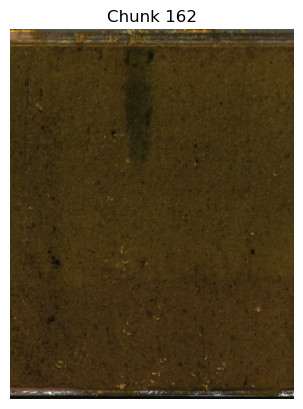

<Figure size 640x480 with 0 Axes>

(-0.5, 996.5, 1299.5, -0.5)

Text(0.5, 1.0, 'Chunk 163')

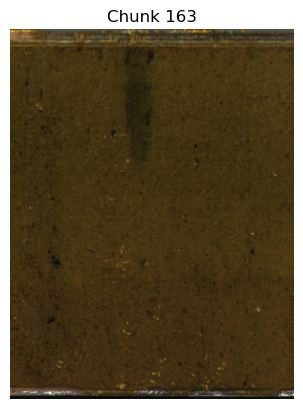

<Figure size 640x480 with 0 Axes>

(-0.5, 996.5, 1299.5, -0.5)

Text(0.5, 1.0, 'Chunk 164')

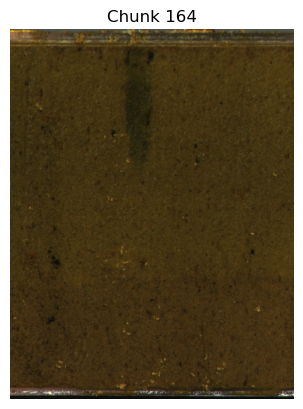

<Figure size 640x480 with 0 Axes>

(-0.5, 996.5, 1299.5, -0.5)

Text(0.5, 1.0, 'Chunk 165')

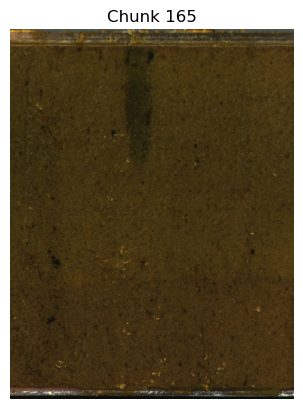

<Figure size 640x480 with 0 Axes>

(-0.5, 996.5, 1299.5, -0.5)

Text(0.5, 1.0, 'Chunk 166')

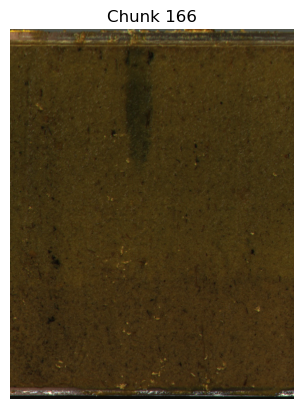

<Figure size 640x480 with 0 Axes>

(-0.5, 996.5, 1299.5, -0.5)

Text(0.5, 1.0, 'Chunk 167')

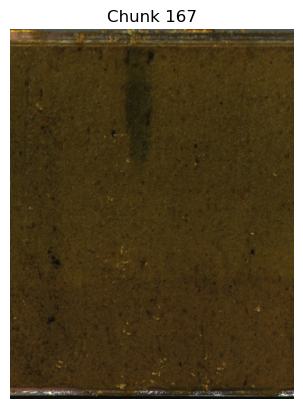

<Figure size 640x480 with 0 Axes>

(-0.5, 996.5, 1299.5, -0.5)

Text(0.5, 1.0, 'Chunk 168')

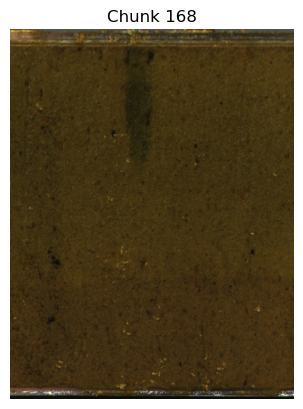

<Figure size 640x480 with 0 Axes>

(-0.5, 996.5, 1299.5, -0.5)

Text(0.5, 1.0, 'Chunk 169')

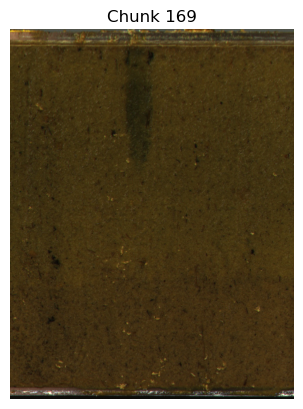

<Figure size 640x480 with 0 Axes>

(-0.5, 996.5, 1299.5, -0.5)

Text(0.5, 1.0, 'Chunk 170')

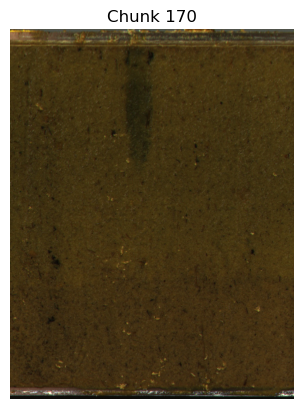

<Figure size 640x480 with 0 Axes>

(-0.5, 996.5, 1299.5, -0.5)

Text(0.5, 1.0, 'Chunk 171')

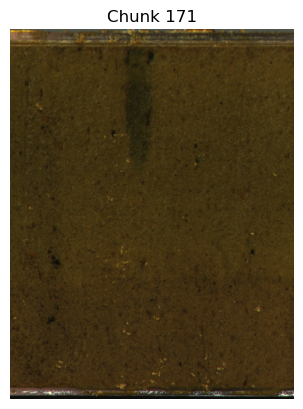

<Figure size 640x480 with 0 Axes>

(-0.5, 996.5, 1299.5, -0.5)

Text(0.5, 1.0, 'Chunk 172')

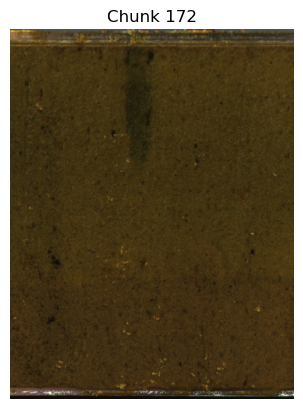

126


/Users/willhoff/Desktop/research_23_24/research_09_11/env/lib/python3.11/site-packages/transformers/models/vit/feature_extraction_vit.py:28: FutureWarning: The class ViTFeatureExtractor is deprecated and will be removed in version 5 of Transformers. Please use ViTImageProcessor instead.
  warnings.warn(


torch.Size([3, 224, 224])


In [9]:
  ################################################################################################################                       
                            ####################### TARGET LABEL #######################
  ################################################################################################################ 


#['sample_id', 'section_depth', 'cum_depth', 'age', 'δ13cvpdb', 'total_c',
        #'%toc', 'δ15nair', 'total_n', '%n', 'c/n',
       #'sample_weight_from_sample_list', 'sample_mass']

target = '%toc'
scaled = True
sample_df = lvid_o
br = False
if br:
    target = 'MBT'
    sample_df = df

if scaled:
    target_col = target + '_scaled'
else:
    target_col = target






## 997 is good chunk size

## Images loaded, tabular loaded, Link together



full_depth = 0
chunk_size = 997
chunks = []
chunk_labels = []

## Pixels to cm
    ## To make sure our depths are accurate
p_to_cm = 5/997


if scaled:
    # Initialize the StandardScaler
    scaler = StandardScaler()

    # Fit the scaler to the target column and transform it
    sample_df[target_col] = scaler.fit_transform(sample_df[[target]])



j = 0
for i,object in enumerate(full_LVID):
    full_end = object.end
    start_pixel = object.start
    end_pixel = object.start + chunk_size
    while end_pixel <= full_end:
        box = (start_pixel, 0, end_pixel, 1300)
            
        ## Adding on labels
        section_data =  sample_df[( sample_df['cum_depth'] >= full_depth) & 
                        ( sample_df['cum_depth'] < (full_depth+5))]

        # Calculate the average target value for the segment
        average_target = section_data[target_col].mean()
        #print(f"target for section {full_depth} to {full_depth + 5}: {average_target}\n")
        if len(section_data) > 0:
            chunk_labels.append(average_target)
            chunk = object.image[0:1300, start_pixel:end_pixel]

            chunks.append(chunk) 

        ## Looks good, dont need to display for now
        # Display the chunk
        #plt.figure()  # Create a new figure for each chunk
        #plt.imshow(chunk)
        #plt.axis('off')  # Hide the axis
        #plt.title(f'Chunk {j+1}')
        #plt.show()
        
        
        ## While loop Increments
        start_pixel += chunk_size
        end_pixel += chunk_size
        j += 1
        if end_pixel > full_end:
            full_depth += (full_end - (end_pixel - chunk_size)) * p_to_cm
        else:
            full_depth += 5
            
    #print(f"\n end of image {i}\n")
        
print(len(chunks))       
        
 # Convert your lists to numpy arrays
images_array = np.array(chunks)
labels_array = np.array(chunk_labels)

# Assuming NaN is represented as np.nan in labels_array
# Create boolean masks
nan_mask = np.isnan(labels_array)
non_nan_mask = ~nan_mask

# Filter the arrays
images_test = images_array[nan_mask]
images_known = images_array[non_nan_mask]
labels_test = labels_array[nan_mask]
labels_known = labels_array[non_nan_mask]


feature_extractor = AutoFeatureExtractor.from_pretrained('facebook/deit-tiny-patch16-224')
inputs = feature_extractor(images=images_known, return_tensors="pt")

print(inputs['pixel_values'][0].shape)


class CustomDataset(Dataset):
    def __init__(self, pixel_values, labels):
        self.pixel_values = pixel_values
        self.labels = labels

    def __len__(self):
        return len(self.pixel_values)

    def __getitem__(self, idx):
        image = self.pixel_values[idx]
        label = self.labels[idx]
        return image, label

# Assuming your pixel_values are already a tensor in the shape [num_images, channels, height, width]
# and labels is a list or a 1-D tensor of label values:
pixel_values_tensor = inputs['pixel_values'] 
labels_tensor = torch.tensor(labels_known, dtype=torch.float32)

# Create the custom dataset
dataset = CustomDataset(pixel_values_tensor, labels_tensor)

# Split the dataset into training and validation sets
train_indices, val_indices = train_test_split(range(len(labels_tensor)), test_size=0.2, random_state=42)

# Subset for train and validation=
train_dataset = Subset(dataset, train_indices)
val_dataset = Subset(dataset, val_indices)

# Create a dataloader for both the training and validation sets
    ## 5 seems like a fine batch size
train_loader = DataLoader(train_dataset, batch_size=5, shuffle=True)
val_loader = DataLoader(val_dataset, batch_size=5, shuffle=False)

In [10]:
## Pretrained model

class CustomViTEmbeddingModel(torch.nn.Module):
    def __init__(self, original_model):
        super(CustomViTEmbeddingModel, self).__init__()
        
        # Extract the necessary layers from the original model
        self.embeddings = original_model.vit.embeddings  #.patch_embeddings
        self.encoder_layer_0 = original_model.vit.encoder.layer[0]
        self.encoder_layer_1 = original_model.vit.encoder.layer[1]
        
        # Assume a square grid of patches to reshape the sequence of patches back into a 2D grid
            ## image: 224x224 ; patch size: 16x16 --> 14x14 
        self.num_patches_side = 14

    def forward(self, x):
        # Apply the embeddings layer
        x = self.embeddings(x)
        
        # Pass the result through the first and second encoder layers
        x = self.encoder_layer_0(x)[0]  # [0] to get the hidden states
        x = self.encoder_layer_1(x)[0]  # [0] to get the hidden states
        
        # x is now the sequence of embeddings for the patches
            # The output x will be a sequence of embeddings, one for each patch of the input images.
            # If you're looking for a single vector representation per image, typically the class token embedding (the first token) is used. 
            # If the model doesn't use a class token, you might need to apply a different pooling strategy over the patch embeddings.
        
        ## Updating to reshape
        
        # Before reshaping, x is in shape [batch_size, num_patches+1, embedding_dim]
        # We discard the first token which is used for classification in the original ViT model
        x = x[:, 1:, :]  # Now in shape [batch_size, num_patches, embedding_dim]
        
        # Reshape to [batch_size, num_patches_side, num_patches_side, embedding_dim]
        x = x.reshape(-1, self.num_patches_side, self.num_patches_side, x.size(-1))

        # Permute to get [batch_size, embedding_dim, num_patches_side, num_patches_side]
        # This is a pseudo-spatial 2D grid, where embedding_dim becomes the channel dimension
        x = x.permute(0, 3, 1, 2)
        
        return x

# Load the pre-trained ViT model
pretrained_vit = ViTForImageClassification.from_pretrained('facebook/deit-tiny-patch16-224')

## Freeze params
for param in pretrained_vit.parameters():
    param.requires_grad = False

# Create model w first three layers and create embedding
custom_model = CustomViTEmbeddingModel(pretrained_vit)
embeddings = custom_model(inputs['pixel_values']) 

print(embeddings[0].shape)


torch.Size([192, 14, 14])


In [19]:
## Adding in CNN component


## CNN for regression
class RegressionCNN(nn.Module):
    ## Maybe try messing w/ kernel_size, padding and stride?
    def __init__(self, embedding_dim):
        super(RegressionCNN, self).__init__()
        
        # First convolutional layer
        self.conv1 = nn.Conv2d(in_channels=embedding_dim, out_channels=64, kernel_size=3, padding=1)
        self.bn1 = nn.BatchNorm2d(64)
        self.relu1 = nn.ReLU()

        # Second convolutional layer
            ## Same amount? Dropout should help it to learn other things
        self.conv2 = nn.Conv2d(in_channels=64, out_channels=128, kernel_size=3, padding=1)
        self.bn2 = nn.BatchNorm2d(128)
        self.relu2 = nn.ReLU()
        
        # Third convolutional layer -- new
        #self.conv3 = nn.Conv2d(in_channels=128, out_channels=64, kernel_size=3, padding=1)
        #self.bn3 = nn.BatchNorm2d(64)
        #self.relu3 = nn.ReLU()
        
        '''# Fourth convolutional layer -- new
        self.conv4 = nn.Conv2d(in_channels=256, out_channels=256, kernel_size=3, padding=1)
        self.bn4 = nn.BatchNorm2d(256)
        self.relu4 = nn.ReLU()
        
        # Max Pooling layer
        self.maxpool = nn.MaxPool2d(kernel_size=2, stride=2)

        # Fifth convolutional layer reducing to 16 output dimensions
        self.conv5 = nn.Conv2d(in_channels=256, out_channels=16, kernel_size=1)  # 1x1 convolution
        self.bn5 = nn.BatchNorm2d(16)
        self.relu5 = nn.ReLU()'''
        
        # Implementing dropout
        self.dropout = nn.Dropout(p=0.1)

        # Adaptive pooling layer to pool down to 1x1
        self.adapt_pool = nn.AdaptiveAvgPool2d((1, 1))
        
        # Final fully connected layer for regressin
        self.fc = nn.Linear(in_features=128, out_features=1)

    def forward(self, x):
        # Apply first convolution, batch norm, and activation
        x = self.relu1(self.bn1(self.conv1(x)))
        #x = self.relu1(self.conv1(x))
        
        # Apply second convolution, batch norm, and activation
        x = self.relu2(self.bn2(self.conv2(x)))
        #x = self.relu2(self.conv2(x))
        
        # Apply third convolution, batch norm, and activation -- new
        #x = self.relu3(self.bn3(self.conv3(x)))
        #x = self.relu3(self.conv3(x))
        
        # Apply fourth convolution, batch norm, and activation -- new
        #x = self.relu4(self.bn4(self.conv4(x)))
        
        # Apply max pooling after the fourth convolutional layer
        #x = self.maxpool(x)

        # Apply fifth convolutional layer
        #x = self.relu5(self.bn5(self.conv5(x)))
        
        # Apply dropout
        x = self.dropout(x)

        # Pool the output from the convolutional layers
        x = self.adapt_pool(x)

        # Flatten the tensor for the fully connected layer
        x = torch.flatten(x, start_dim=1)
        
        # Fully connected layer for regression
        x = self.fc(x)
        return x

def calculate_rmse_and_r2(loader, model, scaler):
    model.eval()
    targets, predictions = [], []
    with torch.no_grad():
        for batch in loader:
            images, labels = batch
            embeddings = custom_model(images)  # Get embeddings from the ViT
            preds = cnn_model(embeddings)  # Pass embeddings to the CNN
            predictions.extend(preds.view(-1).tolist())
            targets.extend(labels.tolist())

    # Scale the targets using the provided scaler
    targets_scaled = scaler.transform(np.array(targets).reshape(-1, 1)).flatten()

    # Convert to tensors
    predictions = torch.tensor(predictions)
    targets_scaled = torch.tensor(targets_scaled)

    # Calculate RMSE on scaled targets
    rmse_value = torch.sqrt(nn.functional.mse_loss(predictions, targets_scaled))

    # Calculate R^2 on scaled targets
    r2_value = r2_score(targets_scaled, predictions)

    return rmse_value.item(), r2_value








In [13]:
def count_layers(model):
    layer_count = 0
    for child in model.children():
        if isinstance(child, nn.Module):
            # If the child is a container module (like nn.Sequential), recursively count its children
            if isinstance(child, nn.Sequential) or isinstance(child, nn.ModuleList):
                layer_count += count_layers(child)
            else:
                layer_count += 1
    return layer_count

def count_conv2d_layers(model):
    layer_count = 0
    for child in model.children():
        # Check if the child is a convolutional layer
        if isinstance(child, nn.Conv2d):
            layer_count += 1
        # If the child is a container module, recursively count its Conv2d children
        elif isinstance(child, nn.Sequential) or isinstance(child, nn.ModuleList):
            layer_count += count_conv2d_layers(child)
    return layer_count

# Example usage:

In [164]:
## Preventing model arch from printing everytime
InteractiveShell.ast_node_interactivity = "last_expr"
warnings.filterwarnings('ignore')

RegressionCNN(
  (conv1): Conv2d(192, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu1): ReLU()
  (conv2): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (bn2): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu2): ReLU()
  (dropout): Dropout(p=0.1, inplace=False)
  (adapt_pool): AdaptiveAvgPool2d(output_size=(1, 1))
  (fc): Linear(in_features=128, out_features=1, bias=True)
)

Epoch 1/100
Train Loss: 1.0106, Train RMSE: 2.2606, Train R2: -24.3587
Val RMSE: 2.2026, Val R2: -30.5736


/Users/willhoff/Desktop/research_23_24/research_09_11/env/lib/python3.11/site-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/Users/willhoff/Desktop/research_23_24/research_09_11/env/lib/python3.11/site-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(


RegressionCNN(
  (conv1): Conv2d(192, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu1): ReLU()
  (conv2): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (bn2): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu2): ReLU()
  (dropout): Dropout(p=0.1, inplace=False)
  (adapt_pool): AdaptiveAvgPool2d(output_size=(1, 1))
  (fc): Linear(in_features=128, out_features=1, bias=True)
)

Epoch 2/100
Train Loss: 0.9066, Train RMSE: 2.2825, Train R2: -24.8537
Val RMSE: 2.2612, Val R2: -32.2747


/Users/willhoff/Desktop/research_23_24/research_09_11/env/lib/python3.11/site-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/Users/willhoff/Desktop/research_23_24/research_09_11/env/lib/python3.11/site-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(


RegressionCNN(
  (conv1): Conv2d(192, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu1): ReLU()
  (conv2): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (bn2): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu2): ReLU()
  (dropout): Dropout(p=0.1, inplace=False)
  (adapt_pool): AdaptiveAvgPool2d(output_size=(1, 1))
  (fc): Linear(in_features=128, out_features=1, bias=True)
)

/Users/willhoff/Desktop/research_23_24/research_09_11/env/lib/python3.11/site-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(


Epoch 3/100
Train Loss: 0.8278, Train RMSE: 2.1964, Train R2: -22.9391
Val RMSE: 2.3094, Val R2: -33.7098


/Users/willhoff/Desktop/research_23_24/research_09_11/env/lib/python3.11/site-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(


RegressionCNN(
  (conv1): Conv2d(192, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu1): ReLU()
  (conv2): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (bn2): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu2): ReLU()
  (dropout): Dropout(p=0.1, inplace=False)
  (adapt_pool): AdaptiveAvgPool2d(output_size=(1, 1))
  (fc): Linear(in_features=128, out_features=1, bias=True)
)

Epoch 4/100
Train Loss: 0.7024, Train RMSE: 2.0322, Train R2: -19.4933
Val RMSE: 2.1140, Val R2: -28.0833


/Users/willhoff/Desktop/research_23_24/research_09_11/env/lib/python3.11/site-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/Users/willhoff/Desktop/research_23_24/research_09_11/env/lib/python3.11/site-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(


RegressionCNN(
  (conv1): Conv2d(192, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu1): ReLU()
  (conv2): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (bn2): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu2): ReLU()
  (dropout): Dropout(p=0.1, inplace=False)
  (adapt_pool): AdaptiveAvgPool2d(output_size=(1, 1))
  (fc): Linear(in_features=128, out_features=1, bias=True)
)

Epoch 5/100
Train Loss: 0.6745, Train RMSE: 2.1654, Train R2: -22.2679
Val RMSE: 2.3419, Val R2: -34.6929


/Users/willhoff/Desktop/research_23_24/research_09_11/env/lib/python3.11/site-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/Users/willhoff/Desktop/research_23_24/research_09_11/env/lib/python3.11/site-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(


RegressionCNN(
  (conv1): Conv2d(192, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu1): ReLU()
  (conv2): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (bn2): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu2): ReLU()
  (dropout): Dropout(p=0.1, inplace=False)
  (adapt_pool): AdaptiveAvgPool2d(output_size=(1, 1))
  (fc): Linear(in_features=128, out_features=1, bias=True)
)

Epoch 6/100
Train Loss: 0.5478, Train RMSE: 2.5452, Train R2: -31.1461
Val RMSE: 2.7789, Val R2: -49.2564


/Users/willhoff/Desktop/research_23_24/research_09_11/env/lib/python3.11/site-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/Users/willhoff/Desktop/research_23_24/research_09_11/env/lib/python3.11/site-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(


RegressionCNN(
  (conv1): Conv2d(192, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu1): ReLU()
  (conv2): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (bn2): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu2): ReLU()
  (dropout): Dropout(p=0.1, inplace=False)
  (adapt_pool): AdaptiveAvgPool2d(output_size=(1, 1))
  (fc): Linear(in_features=128, out_features=1, bias=True)
)

Epoch 7/100
Train Loss: 0.5299, Train RMSE: 2.1463, Train R2: -21.8587
Val RMSE: 2.3926, Val R2: -36.2559


/Users/willhoff/Desktop/research_23_24/research_09_11/env/lib/python3.11/site-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/Users/willhoff/Desktop/research_23_24/research_09_11/env/lib/python3.11/site-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(


RegressionCNN(
  (conv1): Conv2d(192, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu1): ReLU()
  (conv2): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (bn2): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu2): ReLU()
  (dropout): Dropout(p=0.1, inplace=False)
  (adapt_pool): AdaptiveAvgPool2d(output_size=(1, 1))
  (fc): Linear(in_features=128, out_features=1, bias=True)
)

Epoch 8/100
Train Loss: 0.5225, Train RMSE: 2.3985, Train R2: -27.5464
Val RMSE: 2.6395, Val R2: -44.3428


/Users/willhoff/Desktop/research_23_24/research_09_11/env/lib/python3.11/site-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/Users/willhoff/Desktop/research_23_24/research_09_11/env/lib/python3.11/site-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(


RegressionCNN(
  (conv1): Conv2d(192, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu1): ReLU()
  (conv2): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (bn2): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu2): ReLU()
  (dropout): Dropout(p=0.1, inplace=False)
  (adapt_pool): AdaptiveAvgPool2d(output_size=(1, 1))
  (fc): Linear(in_features=128, out_features=1, bias=True)
)

Epoch 9/100
Train Loss: 0.4058, Train RMSE: 2.3484, Train R2: -26.3662
Val RMSE: 2.6170, Val R2: -43.5720


/Users/willhoff/Desktop/research_23_24/research_09_11/env/lib/python3.11/site-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/Users/willhoff/Desktop/research_23_24/research_09_11/env/lib/python3.11/site-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(


RegressionCNN(
  (conv1): Conv2d(192, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu1): ReLU()
  (conv2): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (bn2): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu2): ReLU()
  (dropout): Dropout(p=0.1, inplace=False)
  (adapt_pool): AdaptiveAvgPool2d(output_size=(1, 1))
  (fc): Linear(in_features=128, out_features=1, bias=True)
)

Epoch 10/100
Train Loss: 0.3894, Train RMSE: 1.8622, Train R2: -16.2084
Val RMSE: 2.1688, Val R2: -29.6117


/Users/willhoff/Desktop/research_23_24/research_09_11/env/lib/python3.11/site-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/Users/willhoff/Desktop/research_23_24/research_09_11/env/lib/python3.11/site-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(


RegressionCNN(
  (conv1): Conv2d(192, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu1): ReLU()
  (conv2): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (bn2): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu2): ReLU()
  (dropout): Dropout(p=0.1, inplace=False)
  (adapt_pool): AdaptiveAvgPool2d(output_size=(1, 1))
  (fc): Linear(in_features=128, out_features=1, bias=True)
)

Epoch 11/100
Train Loss: 0.3011, Train RMSE: 2.3618, Train R2: -26.6794
Val RMSE: 2.6869, Val R2: -45.9847


/Users/willhoff/Desktop/research_23_24/research_09_11/env/lib/python3.11/site-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/Users/willhoff/Desktop/research_23_24/research_09_11/env/lib/python3.11/site-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(


RegressionCNN(
  (conv1): Conv2d(192, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu1): ReLU()
  (conv2): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (bn2): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu2): ReLU()
  (dropout): Dropout(p=0.1, inplace=False)
  (adapt_pool): AdaptiveAvgPool2d(output_size=(1, 1))
  (fc): Linear(in_features=128, out_features=1, bias=True)
)

Epoch 12/100
Train Loss: 0.3637, Train RMSE: 2.6058, Train R2: -32.6952
Val RMSE: 2.9264, Val R2: -54.7354


/Users/willhoff/Desktop/research_23_24/research_09_11/env/lib/python3.11/site-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/Users/willhoff/Desktop/research_23_24/research_09_11/env/lib/python3.11/site-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(


RegressionCNN(
  (conv1): Conv2d(192, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu1): ReLU()
  (conv2): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (bn2): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu2): ReLU()
  (dropout): Dropout(p=0.1, inplace=False)
  (adapt_pool): AdaptiveAvgPool2d(output_size=(1, 1))
  (fc): Linear(in_features=128, out_features=1, bias=True)
)

Epoch 13/100
Train Loss: 0.3054, Train RMSE: 2.1019, Train R2: -20.9232
Val RMSE: 2.4400, Val R2: -37.7476


/Users/willhoff/Desktop/research_23_24/research_09_11/env/lib/python3.11/site-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/Users/willhoff/Desktop/research_23_24/research_09_11/env/lib/python3.11/site-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(


RegressionCNN(
  (conv1): Conv2d(192, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu1): ReLU()
  (conv2): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (bn2): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu2): ReLU()
  (dropout): Dropout(p=0.1, inplace=False)
  (adapt_pool): AdaptiveAvgPool2d(output_size=(1, 1))
  (fc): Linear(in_features=128, out_features=1, bias=True)
)

Epoch 14/100
Train Loss: 0.1929, Train RMSE: 2.4607, Train R2: -29.0476
Val RMSE: 2.7680, Val R2: -48.8627


/Users/willhoff/Desktop/research_23_24/research_09_11/env/lib/python3.11/site-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/Users/willhoff/Desktop/research_23_24/research_09_11/env/lib/python3.11/site-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(


RegressionCNN(
  (conv1): Conv2d(192, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu1): ReLU()
  (conv2): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (bn2): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu2): ReLU()
  (dropout): Dropout(p=0.1, inplace=False)
  (adapt_pool): AdaptiveAvgPool2d(output_size=(1, 1))
  (fc): Linear(in_features=128, out_features=1, bias=True)
)

Epoch 15/100
Train Loss: 0.2906, Train RMSE: 2.3063, Train R2: -25.3957
Val RMSE: 2.5797, Val R2: -42.3104


/Users/willhoff/Desktop/research_23_24/research_09_11/env/lib/python3.11/site-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/Users/willhoff/Desktop/research_23_24/research_09_11/env/lib/python3.11/site-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(


RegressionCNN(
  (conv1): Conv2d(192, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu1): ReLU()
  (conv2): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (bn2): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu2): ReLU()
  (dropout): Dropout(p=0.1, inplace=False)
  (adapt_pool): AdaptiveAvgPool2d(output_size=(1, 1))
  (fc): Linear(in_features=128, out_features=1, bias=True)
)

Epoch 16/100
Train Loss: 0.3337, Train RMSE: 2.0491, Train R2: -19.8364
Val RMSE: 2.3574, Val R2: -35.1666


/Users/willhoff/Desktop/research_23_24/research_09_11/env/lib/python3.11/site-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/Users/willhoff/Desktop/research_23_24/research_09_11/env/lib/python3.11/site-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(


RegressionCNN(
  (conv1): Conv2d(192, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu1): ReLU()
  (conv2): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (bn2): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu2): ReLU()
  (dropout): Dropout(p=0.1, inplace=False)
  (adapt_pool): AdaptiveAvgPool2d(output_size=(1, 1))
  (fc): Linear(in_features=128, out_features=1, bias=True)
)

Epoch 17/100
Train Loss: 0.2652, Train RMSE: 2.6765, Train R2: -34.5472
Val RMSE: 2.9834, Val R2: -56.9250


/Users/willhoff/Desktop/research_23_24/research_09_11/env/lib/python3.11/site-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/Users/willhoff/Desktop/research_23_24/research_09_11/env/lib/python3.11/site-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(


RegressionCNN(
  (conv1): Conv2d(192, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu1): ReLU()
  (conv2): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (bn2): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu2): ReLU()
  (dropout): Dropout(p=0.1, inplace=False)
  (adapt_pool): AdaptiveAvgPool2d(output_size=(1, 1))
  (fc): Linear(in_features=128, out_features=1, bias=True)
)

Epoch 18/100
Train Loss: 0.2154, Train RMSE: 2.2861, Train R2: -24.9350
Val RMSE: 2.6146, Val R2: -43.4913


/Users/willhoff/Desktop/research_23_24/research_09_11/env/lib/python3.11/site-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/Users/willhoff/Desktop/research_23_24/research_09_11/env/lib/python3.11/site-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(


RegressionCNN(
  (conv1): Conv2d(192, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu1): ReLU()
  (conv2): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (bn2): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu2): ReLU()
  (dropout): Dropout(p=0.1, inplace=False)
  (adapt_pool): AdaptiveAvgPool2d(output_size=(1, 1))
  (fc): Linear(in_features=128, out_features=1, bias=True)
)

Epoch 19/100
Train Loss: 0.1796, Train RMSE: 2.6205, Train R2: -33.0774
Val RMSE: 2.9696, Val R2: -56.3909


/Users/willhoff/Desktop/research_23_24/research_09_11/env/lib/python3.11/site-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/Users/willhoff/Desktop/research_23_24/research_09_11/env/lib/python3.11/site-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(


RegressionCNN(
  (conv1): Conv2d(192, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu1): ReLU()
  (conv2): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (bn2): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu2): ReLU()
  (dropout): Dropout(p=0.1, inplace=False)
  (adapt_pool): AdaptiveAvgPool2d(output_size=(1, 1))
  (fc): Linear(in_features=128, out_features=1, bias=True)
)

Epoch 20/100
Train Loss: 0.1314, Train RMSE: 2.1557, Train R2: -22.0603
Val RMSE: 2.5058, Val R2: -39.8639


/Users/willhoff/Desktop/research_23_24/research_09_11/env/lib/python3.11/site-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/Users/willhoff/Desktop/research_23_24/research_09_11/env/lib/python3.11/site-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(


RegressionCNN(
  (conv1): Conv2d(192, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu1): ReLU()
  (conv2): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (bn2): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu2): ReLU()
  (dropout): Dropout(p=0.1, inplace=False)
  (adapt_pool): AdaptiveAvgPool2d(output_size=(1, 1))
  (fc): Linear(in_features=128, out_features=1, bias=True)
)

Epoch 21/100
Train Loss: 0.2962, Train RMSE: 2.5616, Train R2: -31.5627
Val RMSE: 2.8450, Val R2: -51.6777


/Users/willhoff/Desktop/research_23_24/research_09_11/env/lib/python3.11/site-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/Users/willhoff/Desktop/research_23_24/research_09_11/env/lib/python3.11/site-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(


RegressionCNN(
  (conv1): Conv2d(192, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu1): ReLU()
  (conv2): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (bn2): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu2): ReLU()
  (dropout): Dropout(p=0.1, inplace=False)
  (adapt_pool): AdaptiveAvgPool2d(output_size=(1, 1))
  (fc): Linear(in_features=128, out_features=1, bias=True)
)

Epoch 22/100
Train Loss: 0.1529, Train RMSE: 2.4743, Train R2: -29.3808
Val RMSE: 2.8222, Val R2: -50.8374


/Users/willhoff/Desktop/research_23_24/research_09_11/env/lib/python3.11/site-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/Users/willhoff/Desktop/research_23_24/research_09_11/env/lib/python3.11/site-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(


RegressionCNN(
  (conv1): Conv2d(192, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu1): ReLU()
  (conv2): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (bn2): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu2): ReLU()
  (dropout): Dropout(p=0.1, inplace=False)
  (adapt_pool): AdaptiveAvgPool2d(output_size=(1, 1))
  (fc): Linear(in_features=128, out_features=1, bias=True)
)

Epoch 23/100
Train Loss: 0.1668, Train RMSE: 2.3043, Train R2: -25.3492
Val RMSE: 2.6063, Val R2: -43.2097


/Users/willhoff/Desktop/research_23_24/research_09_11/env/lib/python3.11/site-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/Users/willhoff/Desktop/research_23_24/research_09_11/env/lib/python3.11/site-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(


RegressionCNN(
  (conv1): Conv2d(192, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu1): ReLU()
  (conv2): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (bn2): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu2): ReLU()
  (dropout): Dropout(p=0.1, inplace=False)
  (adapt_pool): AdaptiveAvgPool2d(output_size=(1, 1))
  (fc): Linear(in_features=128, out_features=1, bias=True)
)

Epoch 24/100
Train Loss: 0.2525, Train RMSE: 2.4350, Train R2: -28.4217
Val RMSE: 2.7825, Val R2: -49.3860


/Users/willhoff/Desktop/research_23_24/research_09_11/env/lib/python3.11/site-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/Users/willhoff/Desktop/research_23_24/research_09_11/env/lib/python3.11/site-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(


RegressionCNN(
  (conv1): Conv2d(192, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu1): ReLU()
  (conv2): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (bn2): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu2): ReLU()
  (dropout): Dropout(p=0.1, inplace=False)
  (adapt_pool): AdaptiveAvgPool2d(output_size=(1, 1))
  (fc): Linear(in_features=128, out_features=1, bias=True)
)

Epoch 25/100
Train Loss: 0.1286, Train RMSE: 2.3267, Train R2: -25.8629
Val RMSE: 2.6598, Val R2: -45.0403


/Users/willhoff/Desktop/research_23_24/research_09_11/env/lib/python3.11/site-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/Users/willhoff/Desktop/research_23_24/research_09_11/env/lib/python3.11/site-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(


RegressionCNN(
  (conv1): Conv2d(192, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu1): ReLU()
  (conv2): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (bn2): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu2): ReLU()
  (dropout): Dropout(p=0.1, inplace=False)
  (adapt_pool): AdaptiveAvgPool2d(output_size=(1, 1))
  (fc): Linear(in_features=128, out_features=1, bias=True)
)

Epoch 26/100
Train Loss: 0.1838, Train RMSE: 2.0638, Train R2: -20.1353
Val RMSE: 2.3599, Val R2: -35.2447


/Users/willhoff/Desktop/research_23_24/research_09_11/env/lib/python3.11/site-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/Users/willhoff/Desktop/research_23_24/research_09_11/env/lib/python3.11/site-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(


RegressionCNN(
  (conv1): Conv2d(192, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu1): ReLU()
  (conv2): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (bn2): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu2): ReLU()
  (dropout): Dropout(p=0.1, inplace=False)
  (adapt_pool): AdaptiveAvgPool2d(output_size=(1, 1))
  (fc): Linear(in_features=128, out_features=1, bias=True)
)

Epoch 27/100
Train Loss: 0.2041, Train RMSE: 2.4262, Train R2: -28.2103
Val RMSE: 2.7833, Val R2: -49.4180


/Users/willhoff/Desktop/research_23_24/research_09_11/env/lib/python3.11/site-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/Users/willhoff/Desktop/research_23_24/research_09_11/env/lib/python3.11/site-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(


RegressionCNN(
  (conv1): Conv2d(192, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu1): ReLU()
  (conv2): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (bn2): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu2): ReLU()
  (dropout): Dropout(p=0.1, inplace=False)
  (adapt_pool): AdaptiveAvgPool2d(output_size=(1, 1))
  (fc): Linear(in_features=128, out_features=1, bias=True)
)

Epoch 28/100
Train Loss: 0.1454, Train RMSE: 2.7149, Train R2: -35.5766
Val RMSE: 3.0137, Val R2: -58.1076


/Users/willhoff/Desktop/research_23_24/research_09_11/env/lib/python3.11/site-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/Users/willhoff/Desktop/research_23_24/research_09_11/env/lib/python3.11/site-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(


RegressionCNN(
  (conv1): Conv2d(192, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu1): ReLU()
  (conv2): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (bn2): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu2): ReLU()
  (dropout): Dropout(p=0.1, inplace=False)
  (adapt_pool): AdaptiveAvgPool2d(output_size=(1, 1))
  (fc): Linear(in_features=128, out_features=1, bias=True)
)

Epoch 29/100
Train Loss: 0.1696, Train RMSE: 2.1123, Train R2: -21.1405
Val RMSE: 2.4602, Val R2: -38.3902


/Users/willhoff/Desktop/research_23_24/research_09_11/env/lib/python3.11/site-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/Users/willhoff/Desktop/research_23_24/research_09_11/env/lib/python3.11/site-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(


RegressionCNN(
  (conv1): Conv2d(192, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu1): ReLU()
  (conv2): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (bn2): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu2): ReLU()
  (dropout): Dropout(p=0.1, inplace=False)
  (adapt_pool): AdaptiveAvgPool2d(output_size=(1, 1))
  (fc): Linear(in_features=128, out_features=1, bias=True)
)

Epoch 30/100
Train Loss: 0.1326, Train RMSE: 2.4762, Train R2: -29.4260
Val RMSE: 2.8022, Val R2: -50.1033


/Users/willhoff/Desktop/research_23_24/research_09_11/env/lib/python3.11/site-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/Users/willhoff/Desktop/research_23_24/research_09_11/env/lib/python3.11/site-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(


RegressionCNN(
  (conv1): Conv2d(192, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu1): ReLU()
  (conv2): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (bn2): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu2): ReLU()
  (dropout): Dropout(p=0.1, inplace=False)
  (adapt_pool): AdaptiveAvgPool2d(output_size=(1, 1))
  (fc): Linear(in_features=128, out_features=1, bias=True)
)

Epoch 31/100
Train Loss: 0.1610, Train RMSE: 2.5261, Train R2: -30.6645
Val RMSE: 2.8879, Val R2: -53.2754


/Users/willhoff/Desktop/research_23_24/research_09_11/env/lib/python3.11/site-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/Users/willhoff/Desktop/research_23_24/research_09_11/env/lib/python3.11/site-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(


RegressionCNN(
  (conv1): Conv2d(192, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu1): ReLU()
  (conv2): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (bn2): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu2): ReLU()
  (dropout): Dropout(p=0.1, inplace=False)
  (adapt_pool): AdaptiveAvgPool2d(output_size=(1, 1))
  (fc): Linear(in_features=128, out_features=1, bias=True)
)

Epoch 32/100
Train Loss: 0.2434, Train RMSE: 2.2609, Train R2: -24.3665
Val RMSE: 2.5809, Val R2: -42.3493


/Users/willhoff/Desktop/research_23_24/research_09_11/env/lib/python3.11/site-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/Users/willhoff/Desktop/research_23_24/research_09_11/env/lib/python3.11/site-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(


RegressionCNN(
  (conv1): Conv2d(192, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu1): ReLU()
  (conv2): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (bn2): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu2): ReLU()
  (dropout): Dropout(p=0.1, inplace=False)
  (adapt_pool): AdaptiveAvgPool2d(output_size=(1, 1))
  (fc): Linear(in_features=128, out_features=1, bias=True)
)

Epoch 33/100
Train Loss: 0.1460, Train RMSE: 2.7338, Train R2: -36.0879
Val RMSE: 3.0687, Val R2: -60.2869


/Users/willhoff/Desktop/research_23_24/research_09_11/env/lib/python3.11/site-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/Users/willhoff/Desktop/research_23_24/research_09_11/env/lib/python3.11/site-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(


RegressionCNN(
  (conv1): Conv2d(192, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu1): ReLU()
  (conv2): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (bn2): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu2): ReLU()
  (dropout): Dropout(p=0.1, inplace=False)
  (adapt_pool): AdaptiveAvgPool2d(output_size=(1, 1))
  (fc): Linear(in_features=128, out_features=1, bias=True)
)

Epoch 34/100
Train Loss: 0.2035, Train RMSE: 2.1626, Train R2: -22.2083
Val RMSE: 2.4679, Val R2: -38.6392


/Users/willhoff/Desktop/research_23_24/research_09_11/env/lib/python3.11/site-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/Users/willhoff/Desktop/research_23_24/research_09_11/env/lib/python3.11/site-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(


RegressionCNN(
  (conv1): Conv2d(192, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu1): ReLU()
  (conv2): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (bn2): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu2): ReLU()
  (dropout): Dropout(p=0.1, inplace=False)
  (adapt_pool): AdaptiveAvgPool2d(output_size=(1, 1))
  (fc): Linear(in_features=128, out_features=1, bias=True)
)

Epoch 35/100
Train Loss: 0.1463, Train RMSE: 2.4789, Train R2: -29.4943
Val RMSE: 2.8295, Val R2: -51.1027


/Users/willhoff/Desktop/research_23_24/research_09_11/env/lib/python3.11/site-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/Users/willhoff/Desktop/research_23_24/research_09_11/env/lib/python3.11/site-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(


RegressionCNN(
  (conv1): Conv2d(192, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu1): ReLU()
  (conv2): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (bn2): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu2): ReLU()
  (dropout): Dropout(p=0.1, inplace=False)
  (adapt_pool): AdaptiveAvgPool2d(output_size=(1, 1))
  (fc): Linear(in_features=128, out_features=1, bias=True)
)

Epoch 36/100
Train Loss: 0.2879, Train RMSE: 2.2729, Train R2: -24.6347
Val RMSE: 2.6076, Val R2: -43.2535


/Users/willhoff/Desktop/research_23_24/research_09_11/env/lib/python3.11/site-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/Users/willhoff/Desktop/research_23_24/research_09_11/env/lib/python3.11/site-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(


RegressionCNN(
  (conv1): Conv2d(192, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu1): ReLU()
  (conv2): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (bn2): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu2): ReLU()
  (dropout): Dropout(p=0.1, inplace=False)
  (adapt_pool): AdaptiveAvgPool2d(output_size=(1, 1))
  (fc): Linear(in_features=128, out_features=1, bias=True)
)

Epoch 37/100
Train Loss: 0.2100, Train RMSE: 2.2896, Train R2: -25.0146
Val RMSE: 2.5808, Val R2: -42.3467


/Users/willhoff/Desktop/research_23_24/research_09_11/env/lib/python3.11/site-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/Users/willhoff/Desktop/research_23_24/research_09_11/env/lib/python3.11/site-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(


RegressionCNN(
  (conv1): Conv2d(192, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu1): ReLU()
  (conv2): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (bn2): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu2): ReLU()
  (dropout): Dropout(p=0.1, inplace=False)
  (adapt_pool): AdaptiveAvgPool2d(output_size=(1, 1))
  (fc): Linear(in_features=128, out_features=1, bias=True)
)

Epoch 38/100
Train Loss: 0.1535, Train RMSE: 2.7252, Train R2: -35.8544
Val RMSE: 3.0557, Val R2: -59.7666


/Users/willhoff/Desktop/research_23_24/research_09_11/env/lib/python3.11/site-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/Users/willhoff/Desktop/research_23_24/research_09_11/env/lib/python3.11/site-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(


RegressionCNN(
  (conv1): Conv2d(192, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu1): ReLU()
  (conv2): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (bn2): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu2): ReLU()
  (dropout): Dropout(p=0.1, inplace=False)
  (adapt_pool): AdaptiveAvgPool2d(output_size=(1, 1))
  (fc): Linear(in_features=128, out_features=1, bias=True)
)

Epoch 39/100
Train Loss: 0.1493, Train RMSE: 2.3418, Train R2: -26.2137
Val RMSE: 2.6516, Val R2: -44.7570


/Users/willhoff/Desktop/research_23_24/research_09_11/env/lib/python3.11/site-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/Users/willhoff/Desktop/research_23_24/research_09_11/env/lib/python3.11/site-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(


RegressionCNN(
  (conv1): Conv2d(192, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu1): ReLU()
  (conv2): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (bn2): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu2): ReLU()
  (dropout): Dropout(p=0.1, inplace=False)
  (adapt_pool): AdaptiveAvgPool2d(output_size=(1, 1))
  (fc): Linear(in_features=128, out_features=1, bias=True)
)

Epoch 40/100
Train Loss: 0.2700, Train RMSE: 2.1573, Train R2: -22.0941
Val RMSE: 2.4989, Val R2: -39.6397


/Users/willhoff/Desktop/research_23_24/research_09_11/env/lib/python3.11/site-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/Users/willhoff/Desktop/research_23_24/research_09_11/env/lib/python3.11/site-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(


RegressionCNN(
  (conv1): Conv2d(192, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu1): ReLU()
  (conv2): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (bn2): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu2): ReLU()
  (dropout): Dropout(p=0.1, inplace=False)
  (adapt_pool): AdaptiveAvgPool2d(output_size=(1, 1))
  (fc): Linear(in_features=128, out_features=1, bias=True)
)

Epoch 41/100
Train Loss: 0.2294, Train RMSE: 2.3562, Train R2: -26.5494
Val RMSE: 2.6612, Val R2: -45.0907


/Users/willhoff/Desktop/research_23_24/research_09_11/env/lib/python3.11/site-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/Users/willhoff/Desktop/research_23_24/research_09_11/env/lib/python3.11/site-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(


RegressionCNN(
  (conv1): Conv2d(192, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu1): ReLU()
  (conv2): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (bn2): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu2): ReLU()
  (dropout): Dropout(p=0.1, inplace=False)
  (adapt_pool): AdaptiveAvgPool2d(output_size=(1, 1))
  (fc): Linear(in_features=128, out_features=1, bias=True)
)

Epoch 42/100
Train Loss: 0.1660, Train RMSE: 2.3287, Train R2: -25.9108
Val RMSE: 2.6757, Val R2: -45.5926


/Users/willhoff/Desktop/research_23_24/research_09_11/env/lib/python3.11/site-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/Users/willhoff/Desktop/research_23_24/research_09_11/env/lib/python3.11/site-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(


RegressionCNN(
  (conv1): Conv2d(192, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu1): ReLU()
  (conv2): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (bn2): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu2): ReLU()
  (dropout): Dropout(p=0.1, inplace=False)
  (adapt_pool): AdaptiveAvgPool2d(output_size=(1, 1))
  (fc): Linear(in_features=128, out_features=1, bias=True)
)

Epoch 43/100
Train Loss: 0.1484, Train RMSE: 2.6395, Train R2: -33.5713
Val RMSE: 2.9689, Val R2: -56.3647


/Users/willhoff/Desktop/research_23_24/research_09_11/env/lib/python3.11/site-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/Users/willhoff/Desktop/research_23_24/research_09_11/env/lib/python3.11/site-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(


RegressionCNN(
  (conv1): Conv2d(192, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu1): ReLU()
  (conv2): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (bn2): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu2): ReLU()
  (dropout): Dropout(p=0.1, inplace=False)
  (adapt_pool): AdaptiveAvgPool2d(output_size=(1, 1))
  (fc): Linear(in_features=128, out_features=1, bias=True)
)

Epoch 44/100
Train Loss: 0.2850, Train RMSE: 2.2675, Train R2: -24.5132
Val RMSE: 2.5968, Val R2: -42.8876


/Users/willhoff/Desktop/research_23_24/research_09_11/env/lib/python3.11/site-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/Users/willhoff/Desktop/research_23_24/research_09_11/env/lib/python3.11/site-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(


RegressionCNN(
  (conv1): Conv2d(192, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu1): ReLU()
  (conv2): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (bn2): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu2): ReLU()
  (dropout): Dropout(p=0.1, inplace=False)
  (adapt_pool): AdaptiveAvgPool2d(output_size=(1, 1))
  (fc): Linear(in_features=128, out_features=1, bias=True)
)

Epoch 45/100
Train Loss: 0.2158, Train RMSE: 2.4876, Train R2: -29.7082
Val RMSE: 2.8233, Val R2: -50.8744


/Users/willhoff/Desktop/research_23_24/research_09_11/env/lib/python3.11/site-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/Users/willhoff/Desktop/research_23_24/research_09_11/env/lib/python3.11/site-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(


RegressionCNN(
  (conv1): Conv2d(192, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu1): ReLU()
  (conv2): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (bn2): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu2): ReLU()
  (dropout): Dropout(p=0.1, inplace=False)
  (adapt_pool): AdaptiveAvgPool2d(output_size=(1, 1))
  (fc): Linear(in_features=128, out_features=1, bias=True)
)

Epoch 46/100
Train Loss: 0.1306, Train RMSE: 2.6183, Train R2: -33.0180
Val RMSE: 2.9407, Val R2: -55.2808


/Users/willhoff/Desktop/research_23_24/research_09_11/env/lib/python3.11/site-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/Users/willhoff/Desktop/research_23_24/research_09_11/env/lib/python3.11/site-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(


RegressionCNN(
  (conv1): Conv2d(192, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu1): ReLU()
  (conv2): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (bn2): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu2): ReLU()
  (dropout): Dropout(p=0.1, inplace=False)
  (adapt_pool): AdaptiveAvgPool2d(output_size=(1, 1))
  (fc): Linear(in_features=128, out_features=1, bias=True)
)

Epoch 47/100
Train Loss: 0.1335, Train RMSE: 2.3101, Train R2: -25.4816
Val RMSE: 2.6434, Val R2: -44.4758


/Users/willhoff/Desktop/research_23_24/research_09_11/env/lib/python3.11/site-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/Users/willhoff/Desktop/research_23_24/research_09_11/env/lib/python3.11/site-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(


RegressionCNN(
  (conv1): Conv2d(192, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu1): ReLU()
  (conv2): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (bn2): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu2): ReLU()
  (dropout): Dropout(p=0.1, inplace=False)
  (adapt_pool): AdaptiveAvgPool2d(output_size=(1, 1))
  (fc): Linear(in_features=128, out_features=1, bias=True)
)

Epoch 48/100
Train Loss: 0.1261, Train RMSE: 2.3534, Train R2: -26.4843
Val RMSE: 2.6562, Val R2: -44.9155


/Users/willhoff/Desktop/research_23_24/research_09_11/env/lib/python3.11/site-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/Users/willhoff/Desktop/research_23_24/research_09_11/env/lib/python3.11/site-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(


RegressionCNN(
  (conv1): Conv2d(192, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu1): ReLU()
  (conv2): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (bn2): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu2): ReLU()
  (dropout): Dropout(p=0.1, inplace=False)
  (adapt_pool): AdaptiveAvgPool2d(output_size=(1, 1))
  (fc): Linear(in_features=128, out_features=1, bias=True)
)

Epoch 49/100
Train Loss: 0.1353, Train RMSE: 2.5618, Train R2: -31.5671
Val RMSE: 2.9021, Val R2: -53.8110


/Users/willhoff/Desktop/research_23_24/research_09_11/env/lib/python3.11/site-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/Users/willhoff/Desktop/research_23_24/research_09_11/env/lib/python3.11/site-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(


RegressionCNN(
  (conv1): Conv2d(192, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu1): ReLU()
  (conv2): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (bn2): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu2): ReLU()
  (dropout): Dropout(p=0.1, inplace=False)
  (adapt_pool): AdaptiveAvgPool2d(output_size=(1, 1))
  (fc): Linear(in_features=128, out_features=1, bias=True)
)

Epoch 50/100
Train Loss: 0.2131, Train RMSE: 2.3085, Train R2: -25.4441
Val RMSE: 2.6319, Val R2: -44.0796


/Users/willhoff/Desktop/research_23_24/research_09_11/env/lib/python3.11/site-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/Users/willhoff/Desktop/research_23_24/research_09_11/env/lib/python3.11/site-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(


RegressionCNN(
  (conv1): Conv2d(192, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu1): ReLU()
  (conv2): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (bn2): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu2): ReLU()
  (dropout): Dropout(p=0.1, inplace=False)
  (adapt_pool): AdaptiveAvgPool2d(output_size=(1, 1))
  (fc): Linear(in_features=128, out_features=1, bias=True)
)

Epoch 51/100
Train Loss: 0.1312, Train RMSE: 2.4695, Train R2: -29.2619
Val RMSE: 2.7658, Val R2: -48.7858


/Users/willhoff/Desktop/research_23_24/research_09_11/env/lib/python3.11/site-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/Users/willhoff/Desktop/research_23_24/research_09_11/env/lib/python3.11/site-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(


RegressionCNN(
  (conv1): Conv2d(192, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu1): ReLU()
  (conv2): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (bn2): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu2): ReLU()
  (dropout): Dropout(p=0.1, inplace=False)
  (adapt_pool): AdaptiveAvgPool2d(output_size=(1, 1))
  (fc): Linear(in_features=128, out_features=1, bias=True)
)

Epoch 52/100
Train Loss: 0.2071, Train RMSE: 2.3835, Train R2: -27.1913
Val RMSE: 2.7161, Val R2: -47.0116


/Users/willhoff/Desktop/research_23_24/research_09_11/env/lib/python3.11/site-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/Users/willhoff/Desktop/research_23_24/research_09_11/env/lib/python3.11/site-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(


RegressionCNN(
  (conv1): Conv2d(192, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu1): ReLU()
  (conv2): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (bn2): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu2): ReLU()
  (dropout): Dropout(p=0.1, inplace=False)
  (adapt_pool): AdaptiveAvgPool2d(output_size=(1, 1))
  (fc): Linear(in_features=128, out_features=1, bias=True)
)

Epoch 53/100
Train Loss: 0.1943, Train RMSE: 2.4056, Train R2: -27.7167
Val RMSE: 2.7258, Val R2: -47.3545


/Users/willhoff/Desktop/research_23_24/research_09_11/env/lib/python3.11/site-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/Users/willhoff/Desktop/research_23_24/research_09_11/env/lib/python3.11/site-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(


RegressionCNN(
  (conv1): Conv2d(192, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu1): ReLU()
  (conv2): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (bn2): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu2): ReLU()
  (dropout): Dropout(p=0.1, inplace=False)
  (adapt_pool): AdaptiveAvgPool2d(output_size=(1, 1))
  (fc): Linear(in_features=128, out_features=1, bias=True)
)

Epoch 54/100
Train Loss: 0.1930, Train RMSE: 2.3935, Train R2: -27.4289
Val RMSE: 2.6884, Val R2: -46.0365


/Users/willhoff/Desktop/research_23_24/research_09_11/env/lib/python3.11/site-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/Users/willhoff/Desktop/research_23_24/research_09_11/env/lib/python3.11/site-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(


RegressionCNN(
  (conv1): Conv2d(192, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu1): ReLU()
  (conv2): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (bn2): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu2): ReLU()
  (dropout): Dropout(p=0.1, inplace=False)
  (adapt_pool): AdaptiveAvgPool2d(output_size=(1, 1))
  (fc): Linear(in_features=128, out_features=1, bias=True)
)

Epoch 55/100
Train Loss: 0.1983, Train RMSE: 2.2974, Train R2: -25.1906
Val RMSE: 2.6247, Val R2: -43.8354


/Users/willhoff/Desktop/research_23_24/research_09_11/env/lib/python3.11/site-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/Users/willhoff/Desktop/research_23_24/research_09_11/env/lib/python3.11/site-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(


RegressionCNN(
  (conv1): Conv2d(192, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu1): ReLU()
  (conv2): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (bn2): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu2): ReLU()
  (dropout): Dropout(p=0.1, inplace=False)
  (adapt_pool): AdaptiveAvgPool2d(output_size=(1, 1))
  (fc): Linear(in_features=128, out_features=1, bias=True)
)

Epoch 56/100
Train Loss: 0.1446, Train RMSE: 2.6445, Train R2: -33.7032
Val RMSE: 2.9849, Val R2: -56.9848


/Users/willhoff/Desktop/research_23_24/research_09_11/env/lib/python3.11/site-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/Users/willhoff/Desktop/research_23_24/research_09_11/env/lib/python3.11/site-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(


RegressionCNN(
  (conv1): Conv2d(192, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu1): ReLU()
  (conv2): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (bn2): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu2): ReLU()
  (dropout): Dropout(p=0.1, inplace=False)
  (adapt_pool): AdaptiveAvgPool2d(output_size=(1, 1))
  (fc): Linear(in_features=128, out_features=1, bias=True)
)

Epoch 57/100
Train Loss: 0.2135, Train RMSE: 2.4310, Train R2: -28.3253
Val RMSE: 2.7605, Val R2: -48.5947


/Users/willhoff/Desktop/research_23_24/research_09_11/env/lib/python3.11/site-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/Users/willhoff/Desktop/research_23_24/research_09_11/env/lib/python3.11/site-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(


RegressionCNN(
  (conv1): Conv2d(192, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu1): ReLU()
  (conv2): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (bn2): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu2): ReLU()
  (dropout): Dropout(p=0.1, inplace=False)
  (adapt_pool): AdaptiveAvgPool2d(output_size=(1, 1))
  (fc): Linear(in_features=128, out_features=1, bias=True)
)

Epoch 58/100
Train Loss: 0.2082, Train RMSE: 2.2438, Train R2: -23.9841
Val RMSE: 2.5636, Val R2: -41.7726


/Users/willhoff/Desktop/research_23_24/research_09_11/env/lib/python3.11/site-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/Users/willhoff/Desktop/research_23_24/research_09_11/env/lib/python3.11/site-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(


RegressionCNN(
  (conv1): Conv2d(192, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu1): ReLU()
  (conv2): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (bn2): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu2): ReLU()
  (dropout): Dropout(p=0.1, inplace=False)
  (adapt_pool): AdaptiveAvgPool2d(output_size=(1, 1))
  (fc): Linear(in_features=128, out_features=1, bias=True)
)

Epoch 59/100
Train Loss: 0.0970, Train RMSE: 2.2305, Train R2: -23.6872
Val RMSE: 2.5427, Val R2: -41.0776


/Users/willhoff/Desktop/research_23_24/research_09_11/env/lib/python3.11/site-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/Users/willhoff/Desktop/research_23_24/research_09_11/env/lib/python3.11/site-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(


RegressionCNN(
  (conv1): Conv2d(192, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu1): ReLU()
  (conv2): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (bn2): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu2): ReLU()
  (dropout): Dropout(p=0.1, inplace=False)
  (adapt_pool): AdaptiveAvgPool2d(output_size=(1, 1))
  (fc): Linear(in_features=128, out_features=1, bias=True)
)

Epoch 60/100
Train Loss: 0.1754, Train RMSE: 2.1985, Train R2: -22.9845
Val RMSE: 2.5355, Val R2: -40.8377


/Users/willhoff/Desktop/research_23_24/research_09_11/env/lib/python3.11/site-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/Users/willhoff/Desktop/research_23_24/research_09_11/env/lib/python3.11/site-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(


RegressionCNN(
  (conv1): Conv2d(192, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu1): ReLU()
  (conv2): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (bn2): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu2): ReLU()
  (dropout): Dropout(p=0.1, inplace=False)
  (adapt_pool): AdaptiveAvgPool2d(output_size=(1, 1))
  (fc): Linear(in_features=128, out_features=1, bias=True)
)

Epoch 61/100
Train Loss: 0.1643, Train RMSE: 2.6854, Train R2: -34.7856
Val RMSE: 3.0367, Val R2: -59.0143


/Users/willhoff/Desktop/research_23_24/research_09_11/env/lib/python3.11/site-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/Users/willhoff/Desktop/research_23_24/research_09_11/env/lib/python3.11/site-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(


RegressionCNN(
  (conv1): Conv2d(192, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu1): ReLU()
  (conv2): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (bn2): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu2): ReLU()
  (dropout): Dropout(p=0.1, inplace=False)
  (adapt_pool): AdaptiveAvgPool2d(output_size=(1, 1))
  (fc): Linear(in_features=128, out_features=1, bias=True)
)

Epoch 62/100
Train Loss: 0.1053, Train RMSE: 2.3597, Train R2: -26.6303
Val RMSE: 2.6884, Val R2: -46.0354


/Users/willhoff/Desktop/research_23_24/research_09_11/env/lib/python3.11/site-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/Users/willhoff/Desktop/research_23_24/research_09_11/env/lib/python3.11/site-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(


RegressionCNN(
  (conv1): Conv2d(192, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu1): ReLU()
  (conv2): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (bn2): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu2): ReLU()
  (dropout): Dropout(p=0.1, inplace=False)
  (adapt_pool): AdaptiveAvgPool2d(output_size=(1, 1))
  (fc): Linear(in_features=128, out_features=1, bias=True)
)

Epoch 63/100
Train Loss: 0.1340, Train RMSE: 2.7731, Train R2: -37.1603
Val RMSE: 3.1216, Val R2: -62.4192


/Users/willhoff/Desktop/research_23_24/research_09_11/env/lib/python3.11/site-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/Users/willhoff/Desktop/research_23_24/research_09_11/env/lib/python3.11/site-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(


RegressionCNN(
  (conv1): Conv2d(192, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu1): ReLU()
  (conv2): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (bn2): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu2): ReLU()
  (dropout): Dropout(p=0.1, inplace=False)
  (adapt_pool): AdaptiveAvgPool2d(output_size=(1, 1))
  (fc): Linear(in_features=128, out_features=1, bias=True)
)

Epoch 64/100
Train Loss: 0.1661, Train RMSE: 2.5740, Train R2: -31.8774
Val RMSE: 2.9130, Val R2: -54.2234


/Users/willhoff/Desktop/research_23_24/research_09_11/env/lib/python3.11/site-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/Users/willhoff/Desktop/research_23_24/research_09_11/env/lib/python3.11/site-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(


RegressionCNN(
  (conv1): Conv2d(192, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu1): ReLU()
  (conv2): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (bn2): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu2): ReLU()
  (dropout): Dropout(p=0.1, inplace=False)
  (adapt_pool): AdaptiveAvgPool2d(output_size=(1, 1))
  (fc): Linear(in_features=128, out_features=1, bias=True)
)

Epoch 65/100
Train Loss: 0.2664, Train RMSE: 1.9738, Train R2: -18.3335
Val RMSE: 2.2589, Val R2: -32.2082


/Users/willhoff/Desktop/research_23_24/research_09_11/env/lib/python3.11/site-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/Users/willhoff/Desktop/research_23_24/research_09_11/env/lib/python3.11/site-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(


RegressionCNN(
  (conv1): Conv2d(192, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu1): ReLU()
  (conv2): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (bn2): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu2): ReLU()
  (dropout): Dropout(p=0.1, inplace=False)
  (adapt_pool): AdaptiveAvgPool2d(output_size=(1, 1))
  (fc): Linear(in_features=128, out_features=1, bias=True)
)

Epoch 66/100
Train Loss: 0.1829, Train RMSE: 2.5978, Train R2: -32.4891
Val RMSE: 2.9161, Val R2: -54.3423


/Users/willhoff/Desktop/research_23_24/research_09_11/env/lib/python3.11/site-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/Users/willhoff/Desktop/research_23_24/research_09_11/env/lib/python3.11/site-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(


RegressionCNN(
  (conv1): Conv2d(192, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu1): ReLU()
  (conv2): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (bn2): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu2): ReLU()
  (dropout): Dropout(p=0.1, inplace=False)
  (adapt_pool): AdaptiveAvgPool2d(output_size=(1, 1))
  (fc): Linear(in_features=128, out_features=1, bias=True)
)

Epoch 67/100
Train Loss: 0.1769, Train RMSE: 2.2385, Train R2: -23.8651
Val RMSE: 2.5415, Val R2: -41.0367


/Users/willhoff/Desktop/research_23_24/research_09_11/env/lib/python3.11/site-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/Users/willhoff/Desktop/research_23_24/research_09_11/env/lib/python3.11/site-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(


RegressionCNN(
  (conv1): Conv2d(192, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu1): ReLU()
  (conv2): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (bn2): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu2): ReLU()
  (dropout): Dropout(p=0.1, inplace=False)
  (adapt_pool): AdaptiveAvgPool2d(output_size=(1, 1))
  (fc): Linear(in_features=128, out_features=1, bias=True)
)

Epoch 68/100
Train Loss: 0.1919, Train RMSE: 2.3970, Train R2: -27.5104
Val RMSE: 2.7075, Val R2: -46.7087


/Users/willhoff/Desktop/research_23_24/research_09_11/env/lib/python3.11/site-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/Users/willhoff/Desktop/research_23_24/research_09_11/env/lib/python3.11/site-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(


RegressionCNN(
  (conv1): Conv2d(192, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu1): ReLU()
  (conv2): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (bn2): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu2): ReLU()
  (dropout): Dropout(p=0.1, inplace=False)
  (adapt_pool): AdaptiveAvgPool2d(output_size=(1, 1))
  (fc): Linear(in_features=128, out_features=1, bias=True)
)

Epoch 69/100
Train Loss: 0.2272, Train RMSE: 2.5385, Train R2: -30.9759
Val RMSE: 2.8725, Val R2: -52.6996


/Users/willhoff/Desktop/research_23_24/research_09_11/env/lib/python3.11/site-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/Users/willhoff/Desktop/research_23_24/research_09_11/env/lib/python3.11/site-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(


RegressionCNN(
  (conv1): Conv2d(192, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu1): ReLU()
  (conv2): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (bn2): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu2): ReLU()
  (dropout): Dropout(p=0.1, inplace=False)
  (adapt_pool): AdaptiveAvgPool2d(output_size=(1, 1))
  (fc): Linear(in_features=128, out_features=1, bias=True)
)

Epoch 70/100
Train Loss: 0.1070, Train RMSE: 2.3211, Train R2: -25.7346
Val RMSE: 2.6329, Val R2: -44.1156


/Users/willhoff/Desktop/research_23_24/research_09_11/env/lib/python3.11/site-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/Users/willhoff/Desktop/research_23_24/research_09_11/env/lib/python3.11/site-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(


RegressionCNN(
  (conv1): Conv2d(192, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu1): ReLU()
  (conv2): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (bn2): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu2): ReLU()
  (dropout): Dropout(p=0.1, inplace=False)
  (adapt_pool): AdaptiveAvgPool2d(output_size=(1, 1))
  (fc): Linear(in_features=128, out_features=1, bias=True)
)

Epoch 71/100
Train Loss: 0.1137, Train RMSE: 2.4058, Train R2: -27.7206
Val RMSE: 2.7443, Val R2: -48.0143


/Users/willhoff/Desktop/research_23_24/research_09_11/env/lib/python3.11/site-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/Users/willhoff/Desktop/research_23_24/research_09_11/env/lib/python3.11/site-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(


RegressionCNN(
  (conv1): Conv2d(192, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu1): ReLU()
  (conv2): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (bn2): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu2): ReLU()
  (dropout): Dropout(p=0.1, inplace=False)
  (adapt_pool): AdaptiveAvgPool2d(output_size=(1, 1))
  (fc): Linear(in_features=128, out_features=1, bias=True)
)

Epoch 72/100
Train Loss: 0.1002, Train RMSE: 2.4688, Train R2: -29.2442
Val RMSE: 2.7681, Val R2: -48.8687


/Users/willhoff/Desktop/research_23_24/research_09_11/env/lib/python3.11/site-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/Users/willhoff/Desktop/research_23_24/research_09_11/env/lib/python3.11/site-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(


RegressionCNN(
  (conv1): Conv2d(192, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu1): ReLU()
  (conv2): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (bn2): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu2): ReLU()
  (dropout): Dropout(p=0.1, inplace=False)
  (adapt_pool): AdaptiveAvgPool2d(output_size=(1, 1))
  (fc): Linear(in_features=128, out_features=1, bias=True)
)

Epoch 73/100
Train Loss: 0.1266, Train RMSE: 2.2871, Train R2: -24.9581
Val RMSE: 2.6108, Val R2: -43.3616


/Users/willhoff/Desktop/research_23_24/research_09_11/env/lib/python3.11/site-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/Users/willhoff/Desktop/research_23_24/research_09_11/env/lib/python3.11/site-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(


RegressionCNN(
  (conv1): Conv2d(192, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu1): ReLU()
  (conv2): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (bn2): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu2): ReLU()
  (dropout): Dropout(p=0.1, inplace=False)
  (adapt_pool): AdaptiveAvgPool2d(output_size=(1, 1))
  (fc): Linear(in_features=128, out_features=1, bias=True)
)

Epoch 74/100
Train Loss: 0.1281, Train RMSE: 2.4894, Train R2: -29.7510
Val RMSE: 2.8100, Val R2: -50.3882


/Users/willhoff/Desktop/research_23_24/research_09_11/env/lib/python3.11/site-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/Users/willhoff/Desktop/research_23_24/research_09_11/env/lib/python3.11/site-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(


RegressionCNN(
  (conv1): Conv2d(192, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu1): ReLU()
  (conv2): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (bn2): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu2): ReLU()
  (dropout): Dropout(p=0.1, inplace=False)
  (adapt_pool): AdaptiveAvgPool2d(output_size=(1, 1))
  (fc): Linear(in_features=128, out_features=1, bias=True)
)

Epoch 75/100
Train Loss: 0.1832, Train RMSE: 2.3858, Train R2: -27.2446
Val RMSE: 2.6679, Val R2: -45.3236


/Users/willhoff/Desktop/research_23_24/research_09_11/env/lib/python3.11/site-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/Users/willhoff/Desktop/research_23_24/research_09_11/env/lib/python3.11/site-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(


RegressionCNN(
  (conv1): Conv2d(192, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu1): ReLU()
  (conv2): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (bn2): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu2): ReLU()
  (dropout): Dropout(p=0.1, inplace=False)
  (adapt_pool): AdaptiveAvgPool2d(output_size=(1, 1))
  (fc): Linear(in_features=128, out_features=1, bias=True)
)

Epoch 76/100
Train Loss: 0.1535, Train RMSE: 2.3429, Train R2: -26.2392
Val RMSE: 2.6214, Val R2: -43.7226


/Users/willhoff/Desktop/research_23_24/research_09_11/env/lib/python3.11/site-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/Users/willhoff/Desktop/research_23_24/research_09_11/env/lib/python3.11/site-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(


RegressionCNN(
  (conv1): Conv2d(192, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu1): ReLU()
  (conv2): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (bn2): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu2): ReLU()
  (dropout): Dropout(p=0.1, inplace=False)
  (adapt_pool): AdaptiveAvgPool2d(output_size=(1, 1))
  (fc): Linear(in_features=128, out_features=1, bias=True)
)

Epoch 77/100
Train Loss: 0.2296, Train RMSE: 2.3100, Train R2: -25.4796
Val RMSE: 2.6653, Val R2: -45.2318


/Users/willhoff/Desktop/research_23_24/research_09_11/env/lib/python3.11/site-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/Users/willhoff/Desktop/research_23_24/research_09_11/env/lib/python3.11/site-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(


RegressionCNN(
  (conv1): Conv2d(192, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu1): ReLU()
  (conv2): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (bn2): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu2): ReLU()
  (dropout): Dropout(p=0.1, inplace=False)
  (adapt_pool): AdaptiveAvgPool2d(output_size=(1, 1))
  (fc): Linear(in_features=128, out_features=1, bias=True)
)

Epoch 78/100
Train Loss: 0.2269, Train RMSE: 2.6365, Train R2: -33.4947
Val RMSE: 2.8798, Val R2: -52.9733


/Users/willhoff/Desktop/research_23_24/research_09_11/env/lib/python3.11/site-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/Users/willhoff/Desktop/research_23_24/research_09_11/env/lib/python3.11/site-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(


RegressionCNN(
  (conv1): Conv2d(192, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu1): ReLU()
  (conv2): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (bn2): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu2): ReLU()
  (dropout): Dropout(p=0.1, inplace=False)
  (adapt_pool): AdaptiveAvgPool2d(output_size=(1, 1))
  (fc): Linear(in_features=128, out_features=1, bias=True)
)

Epoch 79/100
Train Loss: 0.1943, Train RMSE: 2.5417, Train R2: -31.0567
Val RMSE: 2.8267, Val R2: -51.0026


/Users/willhoff/Desktop/research_23_24/research_09_11/env/lib/python3.11/site-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/Users/willhoff/Desktop/research_23_24/research_09_11/env/lib/python3.11/site-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(


RegressionCNN(
  (conv1): Conv2d(192, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu1): ReLU()
  (conv2): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (bn2): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu2): ReLU()
  (dropout): Dropout(p=0.1, inplace=False)
  (adapt_pool): AdaptiveAvgPool2d(output_size=(1, 1))
  (fc): Linear(in_features=128, out_features=1, bias=True)
)

Epoch 80/100
Train Loss: 0.1553, Train RMSE: 2.2566, Train R2: -24.2691
Val RMSE: 2.5403, Val R2: -40.9970


/Users/willhoff/Desktop/research_23_24/research_09_11/env/lib/python3.11/site-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/Users/willhoff/Desktop/research_23_24/research_09_11/env/lib/python3.11/site-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(


RegressionCNN(
  (conv1): Conv2d(192, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu1): ReLU()
  (conv2): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (bn2): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu2): ReLU()
  (dropout): Dropout(p=0.1, inplace=False)
  (adapt_pool): AdaptiveAvgPool2d(output_size=(1, 1))
  (fc): Linear(in_features=128, out_features=1, bias=True)
)

Epoch 81/100
Train Loss: 0.1759, Train RMSE: 2.1673, Train R2: -22.3098
Val RMSE: 2.4552, Val R2: -38.2302


/Users/willhoff/Desktop/research_23_24/research_09_11/env/lib/python3.11/site-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/Users/willhoff/Desktop/research_23_24/research_09_11/env/lib/python3.11/site-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(


RegressionCNN(
  (conv1): Conv2d(192, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu1): ReLU()
  (conv2): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (bn2): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu2): ReLU()
  (dropout): Dropout(p=0.1, inplace=False)
  (adapt_pool): AdaptiveAvgPool2d(output_size=(1, 1))
  (fc): Linear(in_features=128, out_features=1, bias=True)
)

Epoch 82/100
Train Loss: 0.1527, Train RMSE: 2.4585, Train R2: -28.9934
Val RMSE: 2.7533, Val R2: -48.3338


/Users/willhoff/Desktop/research_23_24/research_09_11/env/lib/python3.11/site-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/Users/willhoff/Desktop/research_23_24/research_09_11/env/lib/python3.11/site-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(


RegressionCNN(
  (conv1): Conv2d(192, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu1): ReLU()
  (conv2): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (bn2): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu2): ReLU()
  (dropout): Dropout(p=0.1, inplace=False)
  (adapt_pool): AdaptiveAvgPool2d(output_size=(1, 1))
  (fc): Linear(in_features=128, out_features=1, bias=True)
)

Epoch 83/100
Train Loss: 0.2017, Train RMSE: 2.2970, Train R2: -25.1815
Val RMSE: 2.5943, Val R2: -42.8009


/Users/willhoff/Desktop/research_23_24/research_09_11/env/lib/python3.11/site-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/Users/willhoff/Desktop/research_23_24/research_09_11/env/lib/python3.11/site-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(


RegressionCNN(
  (conv1): Conv2d(192, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu1): ReLU()
  (conv2): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (bn2): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu2): ReLU()
  (dropout): Dropout(p=0.1, inplace=False)
  (adapt_pool): AdaptiveAvgPool2d(output_size=(1, 1))
  (fc): Linear(in_features=128, out_features=1, bias=True)
)

Epoch 84/100
Train Loss: 0.2460, Train RMSE: 2.5146, Train R2: -30.3766
Val RMSE: 2.8208, Val R2: -50.7859


/Users/willhoff/Desktop/research_23_24/research_09_11/env/lib/python3.11/site-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/Users/willhoff/Desktop/research_23_24/research_09_11/env/lib/python3.11/site-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(


RegressionCNN(
  (conv1): Conv2d(192, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu1): ReLU()
  (conv2): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (bn2): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu2): ReLU()
  (dropout): Dropout(p=0.1, inplace=False)
  (adapt_pool): AdaptiveAvgPool2d(output_size=(1, 1))
  (fc): Linear(in_features=128, out_features=1, bias=True)
)

Epoch 85/100
Train Loss: 0.2508, Train RMSE: 2.1829, Train R2: -22.6467
Val RMSE: 2.4694, Val R2: -38.6869


/Users/willhoff/Desktop/research_23_24/research_09_11/env/lib/python3.11/site-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/Users/willhoff/Desktop/research_23_24/research_09_11/env/lib/python3.11/site-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(


RegressionCNN(
  (conv1): Conv2d(192, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu1): ReLU()
  (conv2): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (bn2): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu2): ReLU()
  (dropout): Dropout(p=0.1, inplace=False)
  (adapt_pool): AdaptiveAvgPool2d(output_size=(1, 1))
  (fc): Linear(in_features=128, out_features=1, bias=True)
)

Epoch 86/100
Train Loss: 0.1958, Train RMSE: 2.6247, Train R2: -33.1857
Val RMSE: 2.9467, Val R2: -55.5089


/Users/willhoff/Desktop/research_23_24/research_09_11/env/lib/python3.11/site-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/Users/willhoff/Desktop/research_23_24/research_09_11/env/lib/python3.11/site-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(


RegressionCNN(
  (conv1): Conv2d(192, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu1): ReLU()
  (conv2): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (bn2): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu2): ReLU()
  (dropout): Dropout(p=0.1, inplace=False)
  (adapt_pool): AdaptiveAvgPool2d(output_size=(1, 1))
  (fc): Linear(in_features=128, out_features=1, bias=True)
)

Epoch 87/100
Train Loss: 0.1977, Train RMSE: 2.5065, Train R2: -30.1761
Val RMSE: 2.7951, Val R2: -49.8441


/Users/willhoff/Desktop/research_23_24/research_09_11/env/lib/python3.11/site-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/Users/willhoff/Desktop/research_23_24/research_09_11/env/lib/python3.11/site-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(


RegressionCNN(
  (conv1): Conv2d(192, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu1): ReLU()
  (conv2): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (bn2): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu2): ReLU()
  (dropout): Dropout(p=0.1, inplace=False)
  (adapt_pool): AdaptiveAvgPool2d(output_size=(1, 1))
  (fc): Linear(in_features=128, out_features=1, bias=True)
)

Epoch 88/100
Train Loss: 0.0859, Train RMSE: 2.0388, Train R2: -19.6263
Val RMSE: 2.3172, Val R2: -33.9453


/Users/willhoff/Desktop/research_23_24/research_09_11/env/lib/python3.11/site-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/Users/willhoff/Desktop/research_23_24/research_09_11/env/lib/python3.11/site-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(


RegressionCNN(
  (conv1): Conv2d(192, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu1): ReLU()
  (conv2): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (bn2): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu2): ReLU()
  (dropout): Dropout(p=0.1, inplace=False)
  (adapt_pool): AdaptiveAvgPool2d(output_size=(1, 1))
  (fc): Linear(in_features=128, out_features=1, bias=True)
)

Epoch 89/100
Train Loss: 0.1393, Train RMSE: 2.6184, Train R2: -33.0225
Val RMSE: 2.9273, Val R2: -54.7690


/Users/willhoff/Desktop/research_23_24/research_09_11/env/lib/python3.11/site-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/Users/willhoff/Desktop/research_23_24/research_09_11/env/lib/python3.11/site-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(


RegressionCNN(
  (conv1): Conv2d(192, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu1): ReLU()
  (conv2): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (bn2): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu2): ReLU()
  (dropout): Dropout(p=0.1, inplace=False)
  (adapt_pool): AdaptiveAvgPool2d(output_size=(1, 1))
  (fc): Linear(in_features=128, out_features=1, bias=True)
)

Epoch 90/100
Train Loss: 0.1105, Train RMSE: 2.3279, Train R2: -25.8925
Val RMSE: 2.6457, Val R2: -44.5539


/Users/willhoff/Desktop/research_23_24/research_09_11/env/lib/python3.11/site-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/Users/willhoff/Desktop/research_23_24/research_09_11/env/lib/python3.11/site-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(


RegressionCNN(
  (conv1): Conv2d(192, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu1): ReLU()
  (conv2): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (bn2): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu2): ReLU()
  (dropout): Dropout(p=0.1, inplace=False)
  (adapt_pool): AdaptiveAvgPool2d(output_size=(1, 1))
  (fc): Linear(in_features=128, out_features=1, bias=True)
)

Epoch 91/100
Train Loss: 0.1358, Train RMSE: 2.1341, Train R2: -21.6005
Val RMSE: 2.4331, Val R2: -37.5290


/Users/willhoff/Desktop/research_23_24/research_09_11/env/lib/python3.11/site-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/Users/willhoff/Desktop/research_23_24/research_09_11/env/lib/python3.11/site-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(


RegressionCNN(
  (conv1): Conv2d(192, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu1): ReLU()
  (conv2): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (bn2): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu2): ReLU()
  (dropout): Dropout(p=0.1, inplace=False)
  (adapt_pool): AdaptiveAvgPool2d(output_size=(1, 1))
  (fc): Linear(in_features=128, out_features=1, bias=True)
)

Epoch 92/100
Train Loss: 0.2080, Train RMSE: 2.6616, Train R2: -34.1545
Val RMSE: 2.9751, Val R2: -56.6037


/Users/willhoff/Desktop/research_23_24/research_09_11/env/lib/python3.11/site-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/Users/willhoff/Desktop/research_23_24/research_09_11/env/lib/python3.11/site-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(


RegressionCNN(
  (conv1): Conv2d(192, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu1): ReLU()
  (conv2): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (bn2): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu2): ReLU()
  (dropout): Dropout(p=0.1, inplace=False)
  (adapt_pool): AdaptiveAvgPool2d(output_size=(1, 1))
  (fc): Linear(in_features=128, out_features=1, bias=True)
)

Epoch 93/100
Train Loss: 0.0979, Train RMSE: 2.0188, Train R2: -19.2235
Val RMSE: 2.2920, Val R2: -33.1894


/Users/willhoff/Desktop/research_23_24/research_09_11/env/lib/python3.11/site-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/Users/willhoff/Desktop/research_23_24/research_09_11/env/lib/python3.11/site-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(


RegressionCNN(
  (conv1): Conv2d(192, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu1): ReLU()
  (conv2): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (bn2): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu2): ReLU()
  (dropout): Dropout(p=0.1, inplace=False)
  (adapt_pool): AdaptiveAvgPool2d(output_size=(1, 1))
  (fc): Linear(in_features=128, out_features=1, bias=True)
)

Epoch 94/100
Train Loss: 0.1350, Train RMSE: 2.2015, Train R2: -23.0509
Val RMSE: 2.4943, Val R2: -39.4890


/Users/willhoff/Desktop/research_23_24/research_09_11/env/lib/python3.11/site-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/Users/willhoff/Desktop/research_23_24/research_09_11/env/lib/python3.11/site-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(


RegressionCNN(
  (conv1): Conv2d(192, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu1): ReLU()
  (conv2): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (bn2): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu2): ReLU()
  (dropout): Dropout(p=0.1, inplace=False)
  (adapt_pool): AdaptiveAvgPool2d(output_size=(1, 1))
  (fc): Linear(in_features=128, out_features=1, bias=True)
)

Epoch 95/100
Train Loss: 0.2313, Train RMSE: 2.4654, Train R2: -29.1612
Val RMSE: 2.7737, Val R2: -49.0707


/Users/willhoff/Desktop/research_23_24/research_09_11/env/lib/python3.11/site-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/Users/willhoff/Desktop/research_23_24/research_09_11/env/lib/python3.11/site-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(


RegressionCNN(
  (conv1): Conv2d(192, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu1): ReLU()
  (conv2): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (bn2): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu2): ReLU()
  (dropout): Dropout(p=0.1, inplace=False)
  (adapt_pool): AdaptiveAvgPool2d(output_size=(1, 1))
  (fc): Linear(in_features=128, out_features=1, bias=True)
)

Epoch 96/100
Train Loss: 0.1343, Train RMSE: 2.4282, Train R2: -28.2595
Val RMSE: 2.6961, Val R2: -46.3070


/Users/willhoff/Desktop/research_23_24/research_09_11/env/lib/python3.11/site-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/Users/willhoff/Desktop/research_23_24/research_09_11/env/lib/python3.11/site-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(


RegressionCNN(
  (conv1): Conv2d(192, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu1): ReLU()
  (conv2): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (bn2): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu2): ReLU()
  (dropout): Dropout(p=0.1, inplace=False)
  (adapt_pool): AdaptiveAvgPool2d(output_size=(1, 1))
  (fc): Linear(in_features=128, out_features=1, bias=True)
)

Epoch 97/100
Train Loss: 0.2071, Train RMSE: 2.5531, Train R2: -31.3448
Val RMSE: 2.8885, Val R2: -53.2988


/Users/willhoff/Desktop/research_23_24/research_09_11/env/lib/python3.11/site-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/Users/willhoff/Desktop/research_23_24/research_09_11/env/lib/python3.11/site-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(


RegressionCNN(
  (conv1): Conv2d(192, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu1): ReLU()
  (conv2): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (bn2): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu2): ReLU()
  (dropout): Dropout(p=0.1, inplace=False)
  (adapt_pool): AdaptiveAvgPool2d(output_size=(1, 1))
  (fc): Linear(in_features=128, out_features=1, bias=True)
)

Epoch 98/100
Train Loss: 0.1257, Train RMSE: 2.4663, Train R2: -29.1834
Val RMSE: 2.8135, Val R2: -50.5171


/Users/willhoff/Desktop/research_23_24/research_09_11/env/lib/python3.11/site-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/Users/willhoff/Desktop/research_23_24/research_09_11/env/lib/python3.11/site-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(


RegressionCNN(
  (conv1): Conv2d(192, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu1): ReLU()
  (conv2): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (bn2): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu2): ReLU()
  (dropout): Dropout(p=0.1, inplace=False)
  (adapt_pool): AdaptiveAvgPool2d(output_size=(1, 1))
  (fc): Linear(in_features=128, out_features=1, bias=True)
)

Epoch 99/100
Train Loss: 0.1636, Train RMSE: 2.4797, Train R2: -29.5130
Val RMSE: 2.7069, Val R2: -46.6880


/Users/willhoff/Desktop/research_23_24/research_09_11/env/lib/python3.11/site-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/Users/willhoff/Desktop/research_23_24/research_09_11/env/lib/python3.11/site-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(


RegressionCNN(
  (conv1): Conv2d(192, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu1): ReLU()
  (conv2): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (bn2): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu2): ReLU()
  (dropout): Dropout(p=0.1, inplace=False)
  (adapt_pool): AdaptiveAvgPool2d(output_size=(1, 1))
  (fc): Linear(in_features=128, out_features=1, bias=True)
)

Epoch 100/100
Train Loss: 0.1779, Train RMSE: 2.2207, Train R2: -23.4718
Val RMSE: 2.5067, Val R2: -39.8947


/Users/willhoff/Desktop/research_23_24/research_09_11/env/lib/python3.11/site-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/Users/willhoff/Desktop/research_23_24/research_09_11/env/lib/python3.11/site-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(


<Figure size 1000x500 with 0 Axes>

<Axes: >

Text(0.5, 0, 'Epochs')

Text(0, 0.5, 'Loss')

Text(0.5, 1.0, 'Training Loss Over Epochs')

<Axes: >

Text(0.5, 0, 'Epochs')

Text(0, 0.5, 'RMSE')

Text(0.5, 1.0, 'RMSE Over Epochs')

Text(0.5, 0.98, '%toc RMSE Over Epochs: 0.0001 LR, 2 conv layers, 100 epochs, normalized: True, DO, BN ')

Text(0.5, 0.94, 'RMSE as % of Range: 102.67%')

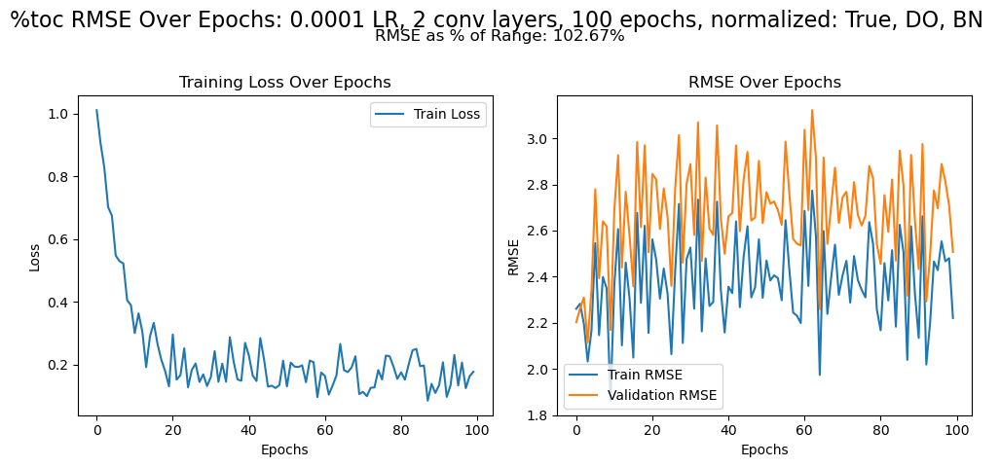

In [21]:
############################################ ############################################ ############################################ 
############################################ ############################################ ############################################ 
###############################################       TRAINING          ############################################ 
############################################ ############################################ ############################################ 
############################################ ############################################ ############################################ 


# Training loop
num_epochs = 100
## Started w 0.001, went up to 0.01
lr = 0.0001

# Training loop
train_losses = []
train_rmses = []
val_rmses = []

# Instantiate the last model
cnn_model = RegressionCNN(embedding_dim=192)

layers = count_conv2d_layers(cnn_model)

# Define a Loss Function and Optimizer
loss_function = nn.MSELoss()


optimizer = optim.Adam(cnn_model.parameters(), lr=lr)

for epoch in range(num_epochs):
    cnn_model.train()
    train_loss = 0
    for batch in train_loader:
        optimizer.zero_grad()
        images, labels = batch
        embeddings = custom_model(images)  # Get embeddings from the ViT
        predictions = cnn_model(embeddings)  # Pass embeddings to the CNN
        loss = loss_function(predictions.squeeze(), labels) 
        loss.backward()
        optimizer.step()
        train_loss += loss.item()
    
    # Calculate average loss over the epoch
    avg_train_loss = train_loss / len(train_loader)
    train_losses.append(avg_train_loss)
    
    # Calculate RMSE and R-squared for training and validation sets
    train_rmse, train_r2 = calculate_rmse_and_r2(train_loader, cnn_model,scaler)
    val_rmse, val_r2 = calculate_rmse_and_r2(val_loader, cnn_model,scaler)
    train_rmses.append(train_rmse)
    val_rmses.append(val_rmse)
    
    # Print out the metrics
    print(f'Epoch {epoch+1}/{num_epochs}')
    print(f'Train Loss: {avg_train_loss:.4f}, Train RMSE: {train_rmse:.4f}, Train R2: {train_r2:.4f}')
    print(f'Val RMSE: {val_rmse:.4f}, Val R2: {val_r2:.4f}')

# Plotting
plt.figure(figsize=(10, 5))

# Plot training loss
plt.subplot(1, 2, 1)
plt.plot(train_losses, label='Train Loss')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.title('Training Loss Over Epochs')
plt.legend()

# Plot RMSE
plt.subplot(1, 2, 2)
plt.plot(train_rmses, label='Train RMSE')
plt.plot(val_rmses, label='Validation RMSE')
plt.xlabel('Epochs')
plt.ylabel('RMSE')
plt.title('RMSE Over Epochs')
plt.legend()

# Add an overall title to the plot
    ## No BN, No dropout
range_target = np.max(sample_df[target]) - np.min(sample_df[target])
if scaled:
    normal_rmse = scaler.inverse_transform([[val_rmse]])[0, 0]
    rmse_perc = (normal_rmse / range_target) * 100
else:
    rmse_perc = (val_rmse / range_target) * 100
main_title = f'{target} RMSE Over Epochs: {lr} LR, {layers} conv layers, {num_epochs} epochs, normalized: {scaled}, DO, BN '
subtitle = f'RMSE as % of Range: {rmse_perc:.2f}%'
plt.suptitle(main_title, fontsize=16)

# Position the subtitle. Adjust the x and y coordinates and fontsize as needed.
plt.figtext(0.5, 0.94, subtitle, ha='center', va='top', fontsize=12)

# Adjust layout to make room for the overall title
plt.tight_layout(rect=[0, 0.03, 1, 0.95])

### 0.0001 seems best

timestamp = datetime.datetime.now().strftime("%Y_%m_%d-%H-%M-%S")
save_dir = 'test_results/LVID'

# Saving the plot
# Ensure the target directory exists
os.makedirs(save_dir, exist_ok=True)
filename = f'{target}_wCompData_rmse_plot_{timestamp}.png'

if target == "C/N":
   filename = f'CN_rmse_plot_{timestamp}.png' 

plt.savefig(os.path.join(save_dir, filename))

plt.show()



In [115]:
range_target = np.max(lvid_o[target_col]) - np.min(lvid_o[target_col])
rmse_percentage = (val_rmse / range_target) * 100
print(rmse_percentage)

79.44852013863441
